In [1]:
import pandas as pd
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
from collections import Counter

import re

In [2]:
# nltk.download()

In [3]:
df_verslagen = pd.read_csv('a:/bloeding-met-patientenlijst-2/bloeding-met-patientenlijst-4-verslagen.csv')
df_verslagen

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00
...,...,...,...,...
9572,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,Consult,Samenvatting: \n1e consult\r\n-Type 1e consult...,2015-03-20 08:13:00
9573,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, Kliniek: vervolgconsult",Samenvatting: \nDecursus\r\n-Type decursus: De...,2015-01-14 15:39:00
9574,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, SEH",Samenvatting: \nVerpleegkundige verslaglegging...,2014-12-21 09:31:00
9575,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, SEH",Samenvatting: \nMedisch Dossier\r\n[ Vk Sputov...,2010-11-10 21:03:00


In [4]:
df_verslagen['verslagen_report_content'][0], df_verslagen['verslagen_report_content'][1]

('Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] NR  [CITY]\r\n\r\n\r\n\r\n\r\n\r\ndatum\r\n29-11-2020\r\nkenmerk\r\n0007475372 / [PATIENTID]\r\nBSN nr.\r\n[BSN]\r\nbetreft\r\nmevrouw [INITIALS] [LASTNAME], geb. [BIRTHDATE] (87)\r\n[STREETNAME], [ZIP]  [CITY]\r\ntel. [PHONENUMBER]\r\n\r\n \r\nGeachte collega,\r\n\r\nBovengenoemde patiënte was opgenomen van 24-11-2020 tot en met 26-11-2020 op de afdeling Maag-, Darm- en Leverziekten in verband met melaena en rectaal bloedverlies. \r\n\r\nVoorgeschiedenis\r\n2002 Diep veneuze trombose en longembolie\r\n2013 Cholecystectomie\r\n2015 Diverticulitis\r\n2016 Atriumfibrilleren met spontane conversie naar sinusritme\r\n2016 Melena, waarvoor geen verklaring werd gevonden. In verband met stabiel Hb en in overleg met patiënte expectatief beleid. \r\n2018 Vermoeidheid bij sinusbradycardie waarvoor stop metoprolol en tambocor. \r\n\r\nAnamnese\r\nVanmiddag rond 13.30u fors helderrood bloedverlies met stolsels. Vermengd met ontlasting, mogelijk was d

In [5]:
# import nltk
# import ssl

# try:
#     _create_unverified_https_context = ssl._create_unverified_context
# except AttributeError:
#     pass
# else:
#     ssl._create_default_https_context = _create_unverified_https_context

# nltk.download('stopwords')
# nltk.download('wordnet')

In [6]:
# clean text
def clean_text(text):
    # remove punctuation
    text = ''.join([word for word in text if word not in string.punctuation])
    # remove stopwords
    text = ' '.join([word for word in text.split() if word.lower() not in stopwords.words('dutch')])
    # remove numbers
    text = ''.join([word for word in text if not word.isdigit()])
    # make everything lowercase
    text = text.lower()
    return text


test = clean_text(df_verslagen['verslagen_report_content'][0])
print(test)


dhr aj dingemans huisarts streetname nr city datum  kenmerk  patientid bsn nr bsn betreft mevrouw initials lastname geb birthdate  streetname zip city tel phonenumber geachte collega bovengenoemde patiënte opgenomen   afdeling maag darm leverziekten verband melaena rectaal bloedverlies voorgeschiedenis  diep veneuze trombose longembolie  cholecystectomie  diverticulitis  atriumfibrilleren spontane conversie sinusritme  melena waarvoor verklaring gevonden verband stabiel hb overleg patiënte expectatief beleid  vermoeidheid sinusbradycardie waarvoor stop metoprolol tambocor anamnese vanmiddag rond u fors helderrood bloedverlies stolsels vermengd ontlasting mogelijk zwart kleur sinds  dagen zeurende pijn bovenbuik maagpijn waarvoor gestopt koffie drinken vet eten afgelopen dagen minder ontlasting minder intake bloed zwart verkleuring bemerkt tractus anamnese verder bijdragend mn lwklachten all penicillines urticaria lichamelijk onderzoek controles spo  hr bpm  nibp mmhg  temp °c  alg acuu

In [7]:
clean_text_list = []
for i in range(len(df_verslagen)):
    cleaned_text = clean_text(df_verslagen['verslagen_report_content'][i])
    clean_text_list.append(cleaned_text)
    

df_verslagen['verslagen_report_content_cleaned'] = clean_text_list

In [8]:
# pip install spacy-lookups-data


In [9]:
df_verslagen_clean = df_verslagen.copy()

In [10]:
df_verslagen_clean['content_words'] = df_verslagen_clean['verslagen_report_content_cleaned']

In [11]:
words_list = []
for i in range(len(df_verslagen)):
    df_verslagen_clean['content_words'][i] = df_verslagen_clean['content_words'][i].split()

df_verslagen_clean.head()

C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\3888130432.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words'][i] = df_verslagen_clean['content_words'][i].split()
C:\Users\Y.vanMegen\AppData\Local\T

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig..."


In [12]:
all_words = []

for i in range(len(df_verslagen_clean)):
    for j in range(len(df_verslagen_clean['content_words'][i])):
        word = df_verslagen_clean['content_words'][i][j]
        all_words.append(word)

all_words

['dhr',
 'aj',
 'dingemans',
 'huisarts',
 'streetname',
 'nr',
 'city',
 'datum',
 'kenmerk',
 'patientid',
 'bsn',
 'nr',
 'bsn',
 'betreft',
 'mevrouw',
 'initials',
 'lastname',
 'geb',
 'birthdate',
 'streetname',
 'zip',
 'city',
 'tel',
 'phonenumber',
 'geachte',
 'collega',
 'bovengenoemde',
 'patiënte',
 'opgenomen',
 'afdeling',
 'maag',
 'darm',
 'leverziekten',
 'verband',
 'melaena',
 'rectaal',
 'bloedverlies',
 'voorgeschiedenis',
 'diep',
 'veneuze',
 'trombose',
 'longembolie',
 'cholecystectomie',
 'diverticulitis',
 'atriumfibrilleren',
 'spontane',
 'conversie',
 'sinusritme',
 'melena',
 'waarvoor',
 'verklaring',
 'gevonden',
 'verband',
 'stabiel',
 'hb',
 'overleg',
 'patiënte',
 'expectatief',
 'beleid',
 'vermoeidheid',
 'sinusbradycardie',
 'waarvoor',
 'stop',
 'metoprolol',
 'tambocor',
 'anamnese',
 'vanmiddag',
 'rond',
 'u',
 'fors',
 'helderrood',
 'bloedverlies',
 'stolsels',
 'vermengd',
 'ontlasting',
 'mogelijk',
 'zwart',
 'kleur',
 'sinds',
 'dag

In [13]:
amount_of_words = Counter(all_words)
amount_of_words

Counter({'mg': 14109,
         'x': 11805,
         'per': 11330,
         'beleid': 10702,
         'dd': 10493,
         'samenvatting': 9795,
         'dag': 9771,
         'onderzoek': 8159,
         'oraal': 7771,
         'anemie': 7405,
         'stuk': 7362,
         'ivm': 7112,
         'opname': 7042,
         'mmoll': 6390,
         'conclusie': 6216,
         'tablet': 6213,
         'hb': 5936,
         'anamnese': 5786,
         'poli': 5192,
         'waarvoor': 5158,
         'rechts': 5083,
         'opdrachten': 5048,
         'lab': 4747,
         'links': 4602,
         'controle': 4600,
         'voorgeschiedenis': 4573,
         'goed': 4474,
         'l': 4316,
         'medicatie': 4314,
         'hypertensie': 4247,
         'bloedverlies': 4218,
         'wel': 4201,
         'b': 4151,
         'afspraak': 3902,
         'patiënt': 3822,
         'beloop': 3685,
         'dr': 3543,
         'start': 3515,
         'klachten': 3329,
         'a': 3299,
     

In [14]:
cleaned_df = df_verslagen_clean.copy()

In [15]:
# Checking the data and common words
num_verslagen = len(cleaned_df)
cleaned_df['word_count'] = cleaned_df['verslagen_report_content_cleaned'].apply(lambda x: len(x.split()))
avg_words_per_article = cleaned_df['word_count'].mean()
all_words = ' '.join(cleaned_df['verslagen_report_content_cleaned']).split()
unique_words = set(all_words)
num_unique_words = len(unique_words)
lexical_variation = len(unique_words) / len(all_words)


print(f"Number of articles: {num_verslagen}")
print(f"Total number of words: {len(all_words)}")
print(f"Average words per article: {avg_words_per_article}")
print(f"Number of unique words: {num_unique_words}")
print(f"Lexical richness: {lexical_variation}")

cleaned_df['tokens'] = cleaned_df['verslagen_report_content_cleaned'].apply(lambda x: x.split())
all_tokens = [word for tokens_list in cleaned_df['tokens'] for word in tokens_list]
word_counter = Counter(all_tokens)
most_common_100 = word_counter.most_common(100)


print("Most common 100 words:")
for word, freq in most_common_100:
    print(f"{word}: {freq}")

Number of articles: 9577
Total number of words: 1555455
Average words per article: 162.4156834081654
Number of unique words: 30757
Lexical richness: 0.019773635367143376
Most common 100 words:
mg: 14109
x: 11805
per: 11330
beleid: 10702
dd: 10493
samenvatting: 9795
dag: 9771
onderzoek: 8159
oraal: 7771
anemie: 7405
stuk: 7362
ivm: 7112
opname: 7042
mmoll: 6390
conclusie: 6216
tablet: 6213
hb: 5936
anamnese: 5786
poli: 5192
waarvoor: 5158
rechts: 5083
opdrachten: 5048
lab: 4747
links: 4602
controle: 4600
voorgeschiedenis: 4573
goed: 4474
l: 4316
medicatie: 4314
hypertensie: 4247
bloedverlies: 4218
wel: 4201
b: 4151
afspraak: 3902
patiënt: 3822
beloop: 3685
dr: 3543
start: 3515
klachten: 3329
a: 3299
aanvullend: 3250
pijn: 3242
af: 3242
wv: 3232
seh: 3217
gezien: 3124
bekende: 3083
gehad: 3059
lichamelijk: 3053
int: 2968
mogelijk: 2947
interne: 2943
voltooid: 2938
type: 2887
xl: 2840
sinds: 2823
ul: 2801
gastroscopie: 2748
e: 2703
bloeding: 2621
huisarts: 2612
afwijkingen: 2593
knoppen: 

In [16]:
cleaned_df.head()

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,word_count,tokens
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,...",468,"[dhr, aj, dingemans, huisarts, streetname, nr,..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div...",111,"[samenvatting, rectaal, bloedverlies, obv, div..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ...",144,"[coloscopie, betreft, mw, initials, lastname, ..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname...",80,"[gastroscopie, betreft, mw, initials, lastname..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig...",147,"[samenvatting, rectaal, bloedverlies, eenmalig..."


In [17]:

unwanted_words = ['mg', 'x', 'per', 'dag', 'samenvatting', 'beleid', 'conclusie', 'mmolL', 'waarvoor', 'goed', 'wel', 'beloop', 'voorgeschiedenis', 'opdrachten', 
                  'gehad', 'aanvullend', 'bekende', 'voltooid', 'mogelijk', 'gezien', 'city', 'bsn', 'nodig', 'firstname', 'streetname', 'lastname', 'postcode', 
                  'anamnese',
                  'dd', 'stuk', 'ivm', 'rechts', 'links', 'dr', 'sinds', 'huisarts', 'datum', 'dagen', 'min', 'extra', 'weken', 'algemeen', 'patiënte', 'overige',
                  'linker', 'week', 'accepteren', 'maanden', 'waarschijnlijk', 'reden', 'uur', 'verdenking', 'ontslag', 'stop', 'tijd']

# Function to remove unwanted words
def remove_words(text):
    pattern = r'\b(?:' + '|'.join(unwanted_words) + r')\b'
    return re.sub(pattern, '', text, flags=re.IGNORECASE).strip()


cleaned_df['verslagen_report_content_cleaned_filtered'] = cleaned_df['verslagen_report_content_cleaned'].apply(remove_words)

In [18]:
# Checking the data and common words
num_verslagen = len(cleaned_df)
cleaned_df['word_count'] = cleaned_df['verslagen_report_content_cleaned_filtered'].apply(lambda x: len(x.split()))
avg_words_per_article = cleaned_df['word_count'].mean()
all_words = ' '.join(cleaned_df['verslagen_report_content_cleaned_filtered']).split()
unique_words = set(all_words)
num_unique_words = len(unique_words)
lexical_variation = len(unique_words) / len(all_words)


print(f"Number of articles: {num_verslagen}")
print(f"Total number of words: {len(all_words)}")
print(f"Average words per article: {avg_words_per_article}")
print(f"Number of unique words: {num_unique_words}")
print(f"Lexical richness: {lexical_variation}")

cleaned_df['tokens'] = cleaned_df['verslagen_report_content_cleaned_filtered'].apply(lambda x: x.split())
all_tokens = [word for tokens_list in cleaned_df['tokens'] for word in tokens_list]
word_counter = Counter(all_tokens)
most_common_100 = word_counter.most_common(100)


print("Most common 100 words:")
for word, freq in most_common_100:
    print(f"{word}: {freq}")

Number of articles: 9577
Total number of words: 1331511
Average words per article: 139.03216038425393
Number of unique words: 30703
Lexical richness: 0.023058765567839846
Most common 100 words:
onderzoek: 8159
oraal: 7771
anemie: 7405
opname: 7042
tablet: 6213
hb: 5936
poli: 5192
lab: 4747
controle: 4600
l: 4316
medicatie: 4314
hypertensie: 4247
bloedverlies: 4218
b: 4151
afspraak: 3902
patiënt: 3822
start: 3515
klachten: 3329
a: 3299
pijn: 3242
af: 3242
wv: 3232
seh: 3217
lichamelijk: 3053
int: 2968
interne: 2943
type: 2887
xl: 2840
ul: 2801
gastroscopie: 2748
e: 2703
bloeding: 2621
afwijkingen: 2593
knoppen: 2554
ontlasting: 2514
nee: 2450
mdl: 2408
coloscopie: 2343
h: 2334
laboratorium: 2327
rr: 2296
gaat: 2295
hemoglobine: 2282
morgen: 2280
decursus: 2274
d: 2265
egfr: 2219
diabetes: 2180
mcv: 2173
normale: 2169
bloed: 2167
chronische: 2106
iv: 2105
atriumfibrilleren: 2094
recidief: 2078
consult: 2014
milde: 1999
stabiel: 1996
normaal: 1990
laatste: 1967
via: 1964
iom: 1932
rectaal

In [19]:
df_verslagen_clean['content_words_lemmatized'] = df_verslagen_clean['verslagen_report_content_cleaned']
df_verslagen_clean.head()

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,...",dhr aj dingemans huisarts streetname nr city d...
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div...",samenvatting rectaal bloedverlies obv divertik...
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ...",coloscopie betreft mw initials lastname adresg...
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname...",gastroscopie betreft mw initials lastname adre...
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig...",samenvatting rectaal bloedverlies eenmalig hd ...


In [20]:
# lemmatizer = WordNetLemmatizer()

# words_list = []
# for i in range(len(df_verslagen_clean)):
#     lst_words = df_verslagen_clean['content_words_lemmatized'][i]
#     lemmatized_words = [lemmatizer.lemmatize(word) for word in lst_words]
#     print(lemmatized_words)
#     df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words

# df_verslagen_clean.head()

In [21]:
import sys
print(f"Python {sys.version_info.major}.{sys.version_info.minor}.{sys.version_info.micro}")


Python 3.11.6


In [22]:
# pip install "C:/Users/Y.vanMegen/Downloads/nl_core_news_sm-3.8.0.tar.gz"


In [23]:
import spacy

nlp = spacy.load("nl_core_news_sm")

In [24]:
import spacy
nlp = spacy.load("nl_core_news_sm")
print("Model loaded successfully!")


Model loaded successfully!


In [25]:
df_verslagen_clean['verslagen_report_content_cleaned'][0] 

'dhr aj dingemans huisarts streetname nr city datum  kenmerk  patientid bsn nr bsn betreft mevrouw initials lastname geb birthdate  streetname zip city tel phonenumber geachte collega bovengenoemde patiënte opgenomen   afdeling maag darm leverziekten verband melaena rectaal bloedverlies voorgeschiedenis  diep veneuze trombose longembolie  cholecystectomie  diverticulitis  atriumfibrilleren spontane conversie sinusritme  melena waarvoor verklaring gevonden verband stabiel hb overleg patiënte expectatief beleid  vermoeidheid sinusbradycardie waarvoor stop metoprolol tambocor anamnese vanmiddag rond u fors helderrood bloedverlies stolsels vermengd ontlasting mogelijk zwart kleur sinds  dagen zeurende pijn bovenbuik maagpijn waarvoor gestopt koffie drinken vet eten afgelopen dagen minder ontlasting minder intake bloed zwart verkleuring bemerkt tractus anamnese verder bijdragend mn lwklachten all penicillines urticaria lichamelijk onderzoek controles spo  hr bpm  nibp mmhg  temp °c  alg acu

In [26]:
# lst_words = df_verslagen_clean['content_words_lemmatized'][i]
# lemmatized_words = nlp(' '.join(lst_words))
# lemmatized_words

# for token in lemmatized_words:
#     print(f"word: {token.text}, lemm_word: {token.lemma_}")

In [27]:
# # lemmatizer = WordNetLemmatizer()

words_list = []
for i in range(len(df_verslagen_clean)):
    print(i)
    words = df_verslagen_clean['content_words_lemmatized'][i]
    # print('words:', words)
    doc = nlp(words)   
    # print('doc:', doc)
    lemmatized_words  = [token.lemma_ for token in doc]
    # print('lemmatized_words:', lemmatized_words)
    # for token in lemmatized_words:
    #     print(f"word: {token.text}, lemm_word: {token.lemma_}")
    df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words

df_verslagen_clean.head()

0
1
2
3
4
5
6
7


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8
9
10
11
12
13
14
15
16
17
18
19
20
21


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

39
40
41
42
43
44
45
46


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

47
48
49
50
51
52
53
54


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

55
56
57
58
59
60
61
62
63
64


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

65
66
67
68
69


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

70
71
72
73
74
75
76
77
78
79
80


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

81
82
83
84
85
86
87
88


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

89
90
91
92
93
94
95
96


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

97
98
99
100
101
102
103
104


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

105
106
107
108
109
110
111
112


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

113
114
115
116
117
118
119
120
121
122
123
124
125


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

126
127
128
129
130
131
132
133
134
135
136


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

137
138
139
140
141
142
143
144
145


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

146
147
148
149
150
151
152
153
154
155


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

156
157
158
159
160
161
162
163
164


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

165
166
167
168
169
170
171
172
173
174
175


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

176
177
178
179
180
181
182


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

183
184
185
186
187
188
189
190
191
192


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

193
194
195
196
197
198
199
200


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

201
202
203
204
205
206
207
208


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

209
210
211
212
213
214
215
216
217


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

218
219
220
221
222
223
224
225
226
227


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

228
229
230
231
232
233
234
235
236


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

237
238
239
240
241
242
243


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

244
245
246
247
248
249


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

250
251
252
253
254
255
256


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

257
258
259
260
261
262
263
264


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

265
266
267
268
269
270
271
272
273
274
275


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

346
347
348
349
350
351
352
353
354
355


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

356
357
358
359


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

360
361
362
363
364


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

365
366
367


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

368
369
370
371


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

372
373
374
375
376


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

377
378
379
380
381


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

382
383
384
385
386


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

387
388
389
390
391
392
393


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

394
395
396
397
398
399


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

400
401
402
403


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

404
405
406
407
408
409
410
411


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

412
413
414
415
416
417
418
419
420
421
422


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

423
424
425
426
427
428
429
430


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

431
432
433
434
435
436


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

437
438
439
440
441


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

442
443
444
445
446
447


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

448
449
450
451
452
453
454
455


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

456
457
458
459
460
461
462
463


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

464
465
466
467
468
469
470
471
472


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

473
474
475
476
477
478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

479
480
481
482
483
484
485
486
487
488
489
490


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

491
492
493
494
495
496
497
498
499
500
501
502
503
504
505
506
507
508


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

509
510
511
512
513
514
515
516
517
518


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

519
520
521
522
523
524


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

525
526
527
528
529
530
531
532
533


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

534
535
536
537
538
539
540
541


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

542
543
544
545
546
547
548
549


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

550
551
552
553
554
555
556


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

557
558
559
560
561
562
563
564
565
566
567


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

568
569
570
571
572
573
574
575
576


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

577
578
579
580
581
582
583
584
585
586


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

587
588
589
590
591
592
593
594
595


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

596
597
598
599
600
601
602
603
604
605


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

606
607
608
609
610
611
612
613
614
615
616
617
618
619
620


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

621
622
623
624
625
626
627
628
629
630
631
632
633
634
635


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

636
637
638
639
640
641
642
643
644
645


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

646
647
648
649
650
651
652
653
654
655
656


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

657
658
659
660
661
662
663
664
665
666
667
668
669
670
671
672
673


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

674
675
676
677
678
679
680
681
682
683
684
685
686
687
688
689
690
691
692
693
694
695
696
697


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

698
699
700
701
702
703
704
705
706
707
708
709
710
711
712
713


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

714
715
716
717
718
719
720
721
722
723
724
725


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

726
727
728
729
730
731
732
733
734
735
736
737
738
739
740
741
742
743
744
745
746


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

747
748
749
750
751
752
753
754
755
756
757
758
759
760
761
762
763
764
765
766
767
768
769
770
771
772
773


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

774
775
776
777
778
779
780
781
782
783
784
785
786
787
788
789
790
791
792
793
794
795
796
797
798
799
800
801
802


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

803
804
805
806
807
808
809
810
811
812
813
814
815
816
817
818
819
820
821
822
823
824
825
826
827
828
829
830
831
832
833
834


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

835
836
837
838
839
840
841
842
843
844
845
846


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

847
848
849
850
851
852
853
854


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

855
856
857
858
859
860
861


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

862
863
864
865
866
867


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

868
869
870
871
872
873
874
875
876


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

877
878
879
880
881
882
883
884


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

885
886
887
888


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

889
890
891
892
893
894
895


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

896
897
898
899
900
901


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

902
903
904
905


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

906
907
908
909
910
911
912
913
914
915


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

916
917
918
919
920
921
922


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

923
924
925
926
927


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

928
929
930
931
932
933


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

934
935
936
937
938


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

939
940
941
942
943
944


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

945
946
947
948


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

949
950
951
952
953


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

954
955
956
957
958


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

959
960
961
962
963


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

964
965
966
967
968
969
970


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

971
972
973
974
975
976
977


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

978
979
980
981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

982
983
984
985
986
987
988


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

989
990
991
992
993


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

994
995
996
997
998
999


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1000
1001
1002
1003
1004
1005
1006
1007
1008


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1009
1010
1011
1012
1013
1014
1015
1016
1017
1018


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1019
1020
1021
1022
1023
1024
1025


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1026
1027
1028
1029


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1030
1031
1032
1033
1034
1035
1036


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1037
1038
1039
1040
1041
1042


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1043
1044
1045
1046
1047
1048
1049
1050


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1051
1052
1053
1054
1055
1056
1057
1058
1059
1060
1061
1062


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1063
1064
1065
1066
1067
1068
1069
1070
1071
1072
1073
1074
1075
1076
1077
1078
1079


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1080
1081
1082
1083
1084
1085
1086
1087
1088
1089
1090
1091
1092
1093


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1094
1095
1096
1097
1098
1099
1100
1101
1102
1103
1104
1105


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1106
1107
1108
1109
1110
1111
1112
1113
1114
1115
1116
1117
1118
1119


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1120
1121
1122
1123
1124
1125
1126
1127
1128
1129
1130


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1131
1132
1133
1134
1135
1136
1137
1138


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1139
1140
1141
1142
1143
1144
1145
1146
1147
1148
1149


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1150
1151
1152
1153
1154
1155
1156
1157
1158
1159
1160


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1161
1162
1163
1164
1165
1166
1167
1168
1169


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1170
1171
1172
1173
1174
1175
1176
1177


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1178
1179
1180
1181
1182
1183
1184
1185
1186
1187
1188
1189


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1190
1191
1192
1193
1194
1195
1196
1197
1198
1199
1200
1201
1202
1203
1204
1205
1206
1207


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1208
1209
1210
1211
1212
1213
1214


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1215
1216
1217
1218
1219
1220
1221
1222
1223
1224
1225
1226
1227
1228
1229
1230
1231
1232


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1233
1234
1235
1236
1237
1238
1239
1240
1241
1242
1243
1244
1245
1246
1247
1248
1249
1250
1251


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1252
1253
1254
1255
1256
1257
1258
1259
1260
1261
1262


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1263
1264
1265
1266
1267
1268
1269
1270
1271
1272
1273
1274
1275
1276
1277
1278
1279
1280
1281
1282
1283
1284


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1285
1286
1287
1288
1289
1290
1291
1292
1293
1294
1295


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1296
1297
1298
1299
1300
1301
1302
1303


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1304
1305
1306
1307
1308
1309
1310


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1311
1312
1313
1314
1315
1316
1317
1318
1319
1320


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1321
1322
1323
1324
1325
1326
1327
1328


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1329
1330
1331
1332
1333
1334
1335
1336
1337
1338
1339
1340
1341


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1342
1343
1344
1345
1346
1347
1348
1349
1350
1351
1352
1353


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1354
1355
1356
1357
1358
1359
1360
1361
1362
1363


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1364
1365
1366
1367
1368
1369
1370
1371
1372
1373
1374
1375
1376
1377
1378


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1379
1380
1381
1382
1383
1384
1385
1386
1387
1388
1389


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1390
1391
1392
1393
1394
1395
1396
1397
1398


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1399
1400
1401
1402


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1403
1404
1405
1406
1407
1408
1409
1410
1411
1412


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1413
1414
1415
1416
1417
1418
1419
1420
1421
1422
1423


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1424
1425
1426
1427
1428
1429
1430
1431
1432
1433
1434


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1435
1436
1437
1438
1439
1440
1441
1442


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1443
1444
1445
1446
1447
1448


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1449
1450
1451
1452
1453
1454
1455
1456


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1457
1458
1459
1460
1461


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1462
1463
1464
1465
1466
1467
1468
1469
1470
1471


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1472
1473
1474
1475
1476
1477
1478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1479
1480
1481
1482
1483
1484
1485


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1486
1487
1488
1489
1490
1491
1492
1493
1494
1495
1496
1497
1498


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1499
1500
1501
1502
1503
1504
1505
1506
1507
1508
1509
1510
1511
1512
1513
1514
1515
1516
1517
1518
1519


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1520
1521
1522
1523
1524
1525
1526
1527
1528
1529
1530
1531
1532
1533
1534


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1535
1536
1537
1538
1539
1540
1541
1542
1543
1544
1545
1546
1547
1548
1549
1550
1551


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1552
1553
1554
1555
1556
1557
1558
1559
1560
1561
1562
1563
1564
1565
1566


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1567
1568
1569
1570
1571
1572
1573
1574
1575


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1576
1577
1578
1579
1580
1581
1582
1583
1584
1585
1586
1587


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1588
1589
1590
1591
1592
1593
1594
1595
1596
1597
1598
1599


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1600
1601
1602
1603
1604
1605
1606
1607
1608
1609
1610
1611
1612


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1613
1614
1615
1616
1617
1618
1619
1620
1621
1622
1623
1624
1625
1626
1627
1628
1629
1630


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1631
1632
1633
1634
1635
1636
1637
1638
1639
1640
1641
1642
1643
1644
1645
1646
1647
1648
1649


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1650
1651
1652
1653
1654
1655
1656
1657
1658
1659
1660
1661
1662


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1663
1664
1665
1666
1667
1668
1669
1670
1671
1672
1673
1674
1675


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1676
1677
1678
1679
1680
1681
1682
1683
1684


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1685
1686
1687
1688
1689
1690
1691
1692
1693


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1694
1695
1696
1697
1698
1699


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1700
1701
1702
1703
1704


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1705
1706
1707
1708
1709


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1710
1711
1712
1713
1714


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1715
1716


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1717
1718
1719
1720
1721


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1722
1723
1724
1725


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1726
1727
1728
1729
1730


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1731
1732
1733
1734
1735


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1736
1737
1738
1739
1740
1741


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1742
1743
1744
1745
1746


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1747
1748
1749
1750
1751


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1752
1753
1754
1755
1756
1757
1758
1759
1760
1761
1762
1763


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1764
1765
1766
1767
1768
1769
1770


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1771
1772
1773
1774
1775
1776
1777
1778
1779
1780
1781
1782
1783
1784
1785
1786


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1787
1788
1789
1790
1791
1792
1793
1794
1795
1796
1797
1798


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1799
1800
1801
1802
1803
1804
1805
1806
1807
1808
1809
1810


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1811
1812
1813
1814
1815
1816
1817
1818
1819
1820
1821
1822
1823


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1824
1825
1826
1827
1828
1829
1830
1831
1832


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1833
1834
1835
1836
1837
1838
1839
1840


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1841
1842
1843
1844
1845
1846


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1847
1848
1849
1850
1851
1852


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1853
1854
1855
1856
1857
1858
1859
1860
1861
1862


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1863
1864
1865
1866
1867


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1868
1869
1870
1871
1872
1873
1874
1875


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1876
1877
1878
1879
1880
1881
1882
1883


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1884
1885
1886
1887
1888
1889
1890
1891


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1892
1893
1894
1895
1896
1897
1898
1899
1900


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1901
1902
1903
1904
1905
1906
1907
1908
1909


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1943
1944
1945
1946
1947
1948
1949
1950
1951
1952


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1953
1954
1955
1956
1957
1958
1959
1960


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1961
1962
1963
1964
1965
1966
1967
1968
1969
1970


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

1993
1994
1995
1996
1997
1998
1999
2000


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2001
2002
2003
2004
2005
2006
2007
2008
2009
2010


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2036
2037
2038
2039
2040
2041
2042
2043
2044
2045


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2059
2060
2061
2062
2063
2064
2065
2066
2067
2068


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2069
2070
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
2081


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2082
2083
2084
2085
2086
2087
2088
2089
2090
2091
2092
2093
2094
2095
2096


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2097
2098
2099
2100
2101
2102
2103
2104
2105


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2106
2107
2108
2109
2110
2111
2112
2113
2114
2115
2116


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2117
2118
2119
2120
2121
2122
2123
2124


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2125
2126
2127
2128
2129
2130
2131


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2132
2133
2134
2135
2136
2137
2138
2139


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2140
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
2151
2152


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2153
2154
2155
2156
2157
2158
2159
2160
2161
2162
2163
2164
2165
2166
2167
2168
2169


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2170
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
2181
2182
2183
2184
2185


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2186
2187
2188
2189
2190
2191
2192
2193
2194
2195
2196


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2197
2198
2199
2200
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210
2211
2212
2213
2214
2215


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2216
2217
2218
2219
2220
2221
2222
2223
2224
2225
2226
2227


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2228
2229
2230
2231
2232
2233
2234
2235
2236
2237
2238
2239
2240
2241
2242
2243


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2244
2245
2246
2247
2248
2249
2250
2251
2252
2253
2254
2255
2256
2257
2258
2259
2260


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
2271
2272
2273
2274
2275
2276
2277
2278


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2279
2280
2281
2282
2283
2284


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2285
2286
2287
2288
2289
2290
2291
2292
2293


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2294
2295
2296
2297
2298
2299
2300


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2301
2302
2303
2304
2305
2306
2307


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2308
2309
2310
2311
2312
2313
2314
2315
2316
2317
2318
2319


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2320
2321
2322
2323


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2324
2325
2326
2327
2328
2329
2330
2331
2332
2333


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2334
2335
2336
2337
2338
2339
2340
2341
2342


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2343
2344
2345
2346
2347
2348
2349
2350
2351


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2352
2353
2354
2355
2356
2357
2358
2359
2360
2361
2362
2363


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2364
2365
2366
2367
2368
2369
2370
2371
2372
2373
2374


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2375
2376
2377
2378
2379
2380
2381
2382
2383


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2384
2385
2386
2387
2388
2389
2390
2391
2392


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2393
2394
2395
2396
2397
2398
2399
2400
2401


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2402
2403
2404
2405
2406
2407
2408
2409
2410
2411
2412
2413
2414
2415
2416
2417
2418


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2419
2420
2421
2422
2423
2424
2425
2426
2427
2428


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2429
2430
2431
2432
2433


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2434
2435
2436
2437
2438
2439
2440
2441
2442
2443


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2444
2445
2446
2447
2448
2449
2450
2451
2452
2453
2454
2455
2456
2457
2458
2459
2460
2461
2462
2463


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2464
2465
2466
2467
2468
2469
2470
2471
2472


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2473
2474
2475
2476
2477
2478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2479
2480
2481
2482
2483
2484
2485


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2486
2487
2488
2489
2490
2491


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2492
2493
2494
2495
2496
2497
2498
2499
2500
2501
2502
2503
2504
2505
2506


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2507
2508
2509


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2510
2511
2512


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2513
2514
2515
2516
2517
2518


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2519
2520
2521
2522
2523


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2524
2525
2526
2527
2528


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2529
2530
2531
2532
2533
2534
2535
2536


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2537
2538
2539
2540
2541
2542
2543
2544
2545
2546


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2547
2548
2549
2550
2551
2552


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2553
2554
2555
2556
2557
2558
2559
2560
2561
2562
2563


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2564
2565
2566
2567
2568
2569
2570


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2571
2572
2573
2574
2575
2576


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2577
2578
2579
2580
2581
2582
2583


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2584
2585
2586
2587
2588
2589
2590


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2591
2592
2593
2594
2595
2596
2597


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2598
2599
2600
2601
2602
2603
2604
2605
2606
2607
2608
2609


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2610
2611
2612
2613
2614
2615
2616
2617
2618
2619
2620
2621
2622
2623


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2624
2625
2626
2627
2628
2629
2630
2631
2632
2633
2634
2635


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2636
2637
2638
2639
2640
2641
2642
2643
2644
2645
2646
2647
2648
2649


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2650
2651
2652
2653
2654
2655
2656
2657
2658
2659
2660
2661


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2662
2663
2664
2665
2666
2667
2668
2669
2670
2671
2672
2673


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2674
2675
2676
2677
2678
2679
2680
2681
2682
2683
2684
2685
2686
2687


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2688
2689
2690
2691
2692
2693
2694
2695
2696
2697
2698
2699
2700
2701
2702


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2703
2704
2705
2706
2707
2708
2709
2710
2711
2712
2713
2714


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2715
2716
2717
2718
2719
2720
2721
2722
2723
2724
2725


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2726
2727
2728
2729
2730
2731
2732
2733
2734
2735
2736
2737
2738
2739
2740
2741
2742


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2743
2744
2745
2746
2747
2748
2749
2750
2751
2752
2753


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2754
2755
2756
2757
2758
2759
2760
2761
2762
2763
2764


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2765
2766
2767
2768
2769
2770
2771
2772
2773
2774
2775
2776
2777


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2778
2779
2780
2781
2782
2783
2784
2785
2786
2787
2788


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2789
2790
2791
2792
2793
2794
2795
2796
2797
2798
2799
2800
2801
2802
2803


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2804
2805
2806
2807
2808
2809
2810
2811
2812
2813
2814


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2815
2816
2817
2818
2819
2820
2821
2822
2823
2824
2825


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2826
2827
2828
2829
2830
2831
2832
2833
2834
2835
2836
2837
2838
2839


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2840
2841
2842
2843
2844
2845
2846
2847
2848
2849
2850
2851


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2852
2853
2854
2855
2856
2857
2858
2859
2860
2861
2862
2863


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2864
2865
2866
2867
2868
2869
2870
2871


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2872
2873
2874
2875
2876
2877
2878
2879
2880


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2881
2882
2883
2884
2885
2886
2887
2888
2889
2890
2891
2892
2893
2894
2895
2896
2897
2898


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2899
2900
2901
2902
2903
2904
2905
2906
2907
2908
2909
2910


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2911
2912
2913
2914
2915
2916


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2917
2918
2919
2920
2921
2922
2923
2924


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2925
2926
2927
2928
2929
2930
2931
2932
2933
2934


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2935
2936
2937
2938
2939
2940
2941
2942
2943
2944
2945
2946
2947


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2948
2949
2950
2951
2952
2953
2954
2955


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2956
2957
2958
2959
2960
2961
2962
2963
2964
2965
2966
2967
2968
2969
2970
2971
2972
2973
2974


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2975
2976
2977
2978
2979
2980
2981
2982
2983
2984


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2985
2986
2987
2988
2989
2990
2991


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

2992
2993
2994
2995
2996
2997
2998
2999
3000
3001
3002
3003


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3004
3005
3006
3007
3008
3009
3010
3011
3012
3013
3014
3015
3016
3017
3018
3019
3020
3021


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3022
3023
3024
3025
3026
3027
3028
3029
3030
3031
3032
3033
3034
3035
3036
3037
3038
3039
3040
3041


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3042
3043
3044
3045
3046
3047
3048
3049
3050
3051
3052
3053
3054


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3055
3056
3057
3058
3059
3060
3061
3062
3063


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3064
3065
3066
3067
3068
3069
3070
3071
3072


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3073
3074
3075
3076


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3077
3078


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3079
3080
3081
3082


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3083
3084
3085
3086


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3087
3088
3089
3090
3091
3092
3093
3094
3095


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3096
3097
3098
3099
3100
3101
3102
3103
3104
3105
3106
3107
3108


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3109
3110
3111
3112
3113
3114
3115
3116


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3117
3118
3119
3120
3121
3122
3123


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3124
3125
3126
3127
3128
3129


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3130
3131
3132
3133
3134
3135
3136
3137


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3138
3139
3140
3141


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3142
3143
3144
3145
3146
3147
3148
3149
3150
3151
3152
3153
3154


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3155
3156
3157
3158
3159
3160
3161
3162
3163
3164
3165
3166
3167
3168
3169
3170
3171
3172
3173
3174


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3175
3176
3177
3178
3179
3180
3181
3182
3183
3184
3185


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3186
3187
3188
3189
3190
3191
3192
3193
3194
3195


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3196
3197
3198
3199
3200
3201
3202
3203
3204
3205
3206
3207
3208
3209
3210
3211
3212
3213
3214
3215
3216
3217


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3218
3219
3220
3221
3222
3223
3224
3225
3226


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3227
3228
3229
3230
3231
3232
3233
3234
3235
3236


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3237
3238
3239
3240
3241
3242
3243


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3244
3245
3246
3247
3248
3249
3250


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3251
3252
3253
3254
3255
3256
3257
3258


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3259
3260
3261
3262
3263
3264
3265
3266
3267
3268
3269
3270
3271
3272
3273


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3274
3275
3276
3277
3278
3279
3280
3281


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3282
3283
3284
3285


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3286
3287
3288
3289
3290


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3291
3292
3293
3294
3295
3296


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3297
3298
3299


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3300
3301
3302
3303
3304
3305


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3306
3307
3308
3309
3310
3311
3312
3313
3314
3315
3316


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3317
3318
3319
3320
3321
3322


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3323
3324
3325
3326
3327
3328


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3329
3330
3331


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3332
3333
3334
3335
3336


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3337
3338
3339
3340
3341
3342


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3343
3344
3345
3346


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3347
3348
3349


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3350
3351
3352
3353


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3354
3355
3356
3357
3358
3359


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3360
3361
3362
3363
3364
3365
3366


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3367
3368
3369
3370
3371


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3372
3373
3374
3375


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3376
3377
3378
3379
3380
3381
3382
3383


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3384
3385
3386
3387
3388


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3389
3390
3391


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3392
3393
3394
3395
3396
3397
3398
3399
3400
3401
3402


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3403
3404
3405
3406
3407
3408
3409
3410
3411
3412


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3413
3414
3415
3416
3417
3418
3419
3420
3421
3422
3423
3424
3425
3426


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3427
3428
3429
3430
3431
3432
3433
3434
3435
3436
3437


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3438
3439
3440
3441
3442
3443
3444
3445
3446
3447
3448
3449
3450
3451
3452
3453
3454
3455
3456


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3457
3458
3459
3460
3461
3462
3463
3464
3465
3466
3467


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3468
3469
3470


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3471
3472


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3473
3474
3475


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3476
3477
3478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3479
3480
3481
3482
3483


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3484
3485
3486


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3487
3488
3489
3490
3491


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3492
3493
3494
3495
3496
3497
3498


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3499
3500
3501
3502
3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3517
3518
3519
3520
3521
3522
3523
3524
3525


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3526
3527
3528
3529
3530
3531


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3532
3533
3534
3535
3536
3537


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3538
3539
3540
3541
3542
3543
3544


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3545
3546
3547
3548
3549
3550


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3551
3552
3553
3554


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3555
3556
3557
3558
3559
3560
3561
3562


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3563
3564
3565
3566
3567
3568


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3569
3570
3571
3572
3573
3574


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3575
3576
3577
3578
3579
3580
3581
3582
3583


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3584
3585
3586
3587


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3588
3589
3590
3591
3592
3593


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3594
3595
3596
3597
3598
3599
3600
3601
3602
3603


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3628
3629
3630
3631
3632


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3633
3634
3635
3636


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3637
3638
3639
3640
3641


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3642
3643
3644
3645
3646
3647


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3648
3649
3650
3651
3652
3653
3654
3655


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3681
3682
3683
3684
3685
3686
3687
3688


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3689
3690
3691
3692
3693
3694


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3706
3707
3708
3709
3710
3711
3712
3713
3714
3715
3716
3717


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3718
3719
3720
3721
3722


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3723
3724
3725
3726
3727
3728


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3729
3730
3731
3732
3733
3734
3735
3736
3737
3738


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3739
3740
3741
3742
3743
3744
3745
3746
3747


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3748
3749
3750
3751
3752
3753
3754


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3755
3756
3757
3758
3759
3760
3761
3762


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3763
3764
3765
3766
3767
3768
3769
3770
3771
3772
3773


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3774
3775
3776
3777
3778
3779
3780
3781
3782


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3783
3784
3785
3786


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3787
3788
3789
3790
3791
3792
3793


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3794
3795
3796
3797
3798
3799
3800
3801
3802


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3803
3804
3805
3806
3807
3808
3809
3810
3811
3812
3813


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3814
3815
3816
3817
3818


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3819
3820
3821
3822
3823
3824
3825
3826


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3827
3828
3829
3830
3831
3832


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3833
3834
3835
3836
3837
3838
3839


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3840
3841
3842
3843
3844
3845
3846
3847
3848
3849
3850


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3851
3852
3853
3854
3855
3856
3857
3858
3859
3860
3861


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3862
3863
3864
3865
3866
3867
3868
3869


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3870
3871
3872
3873
3874
3875
3876
3877
3878


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3879
3880
3881
3882
3883
3884
3885
3886
3887
3888
3889


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3890
3891
3892
3893
3894
3895
3896
3897
3898
3899
3900
3901


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3902
3903
3904
3905
3906
3907
3908
3909
3910
3911
3912
3913
3914
3915
3916
3917


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3918
3919
3920
3921
3922
3923


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3924
3925
3926
3927


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3928
3929
3930
3931
3932
3933
3934
3935
3936


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3937
3938
3939
3940
3941
3942


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3943
3944
3945
3946
3947


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3948
3949
3950
3951
3952
3953
3954


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3955
3956
3957
3958
3959


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3960
3961
3962
3963
3964
3965
3966
3967
3968
3969
3970
3971
3972
3973
3974
3975


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3976
3977
3978
3979
3980
3981
3982
3983
3984
3985
3986
3987


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

3988
3989
3990
3991
3992
3993
3994
3995
3996
3997
3998
3999
4000


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4001
4002
4003
4004
4005
4006
4007
4008
4009
4010
4011
4012
4013
4014
4015


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4016
4017
4018
4019
4020
4021


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4022
4023
4024
4025
4026
4027
4028
4029
4030
4031
4032
4033
4034
4035
4036
4037
4038
4039


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4040
4041
4042
4043
4044
4045
4046
4047
4048
4049
4050
4051
4052
4053
4054


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4055
4056
4057
4058
4059
4060
4061
4062
4063
4064
4065
4066
4067
4068
4069
4070
4071
4072
4073
4074


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4075
4076
4077
4078
4079
4080
4081
4082
4083
4084
4085
4086
4087


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4088
4089
4090
4091
4092


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4093
4094
4095
4096
4097
4098


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4099
4100
4101
4102
4103
4104
4105
4106
4107
4108
4109
4110
4111


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4112
4113
4114
4115
4116
4117
4118


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4119
4120
4121
4122
4123
4124
4125
4126
4127
4128
4129
4130
4131
4132
4133


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4134
4135
4136
4137
4138
4139
4140
4141
4142


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4143
4144
4145
4146
4147
4148
4149
4150
4151


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4152
4153
4154
4155
4156
4157
4158
4159
4160
4161
4162
4163
4164


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4165
4166
4167
4168
4169
4170
4171
4172
4173
4174
4175
4176
4177
4178
4179
4180


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4181
4182
4183
4184
4185
4186
4187
4188
4189
4190
4191


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4192
4193
4194
4195


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4196
4197
4198
4199
4200
4201
4202
4203
4204
4205
4206
4207


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4208
4209
4210
4211
4212
4213
4214
4215
4216
4217
4218


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4219
4220
4221
4222
4223
4224
4225


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4226
4227
4228
4229
4230
4231
4232
4233


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4234
4235
4236
4237
4238
4239
4240
4241
4242
4243
4244


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4245
4246
4247
4248
4249
4250
4251
4252
4253
4254
4255
4256


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4257
4258
4259
4260
4261
4262
4263
4264
4265
4266
4267


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4268
4269
4270
4271
4272
4273
4274
4275
4276


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4277
4278
4279
4280
4281
4282
4283


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4284
4285
4286
4287
4288
4289
4290
4291
4292
4293
4294


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4295
4296
4297
4298
4299
4300
4301
4302
4303
4304


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4305
4306
4307
4308
4309
4310


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4311
4312
4313
4314
4315
4316
4317
4318
4319
4320
4321
4322
4323
4324
4325
4326


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4327
4328
4329
4330
4331
4332
4333
4334
4335
4336
4337
4338
4339
4340
4341
4342
4343


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4344
4345
4346
4347
4348
4349
4350


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4351
4352
4353
4354


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4355
4356
4357
4358
4359
4360


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4361
4362
4363
4364
4365
4366
4367
4368
4369
4370


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4371
4372
4373
4374
4375
4376


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4377
4378
4379
4380


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4381
4382
4383
4384
4385
4386
4387
4388
4389
4390
4391
4392


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4393
4394
4395
4396
4397
4398
4399
4400
4401
4402
4403
4404


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4405
4406
4407
4408
4409
4410
4411
4412
4413


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4414
4415
4416
4417
4418
4419
4420
4421
4422
4423
4424


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4425
4426
4427
4428
4429
4430
4431
4432
4433
4434
4435
4436
4437


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4438
4439
4440
4441
4442
4443
4444
4445
4446
4447


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4448
4449
4450
4451
4452


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4453
4454
4455
4456


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4457
4458
4459
4460
4461
4462
4463
4464
4465
4466
4467


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4468
4469
4470
4471
4472
4473
4474
4475


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4476
4477
4478
4479
4480


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4481
4482
4483
4484
4485
4486


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4487
4488
4489
4490
4491
4492
4493
4494
4495


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4496
4497
4498
4499
4500
4501
4502
4503
4504
4505
4506
4507
4508
4509


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4510
4511
4512
4513
4514
4515
4516
4517
4518
4519
4520
4521


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4522
4523
4524
4525
4526
4527
4528
4529
4530


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4531
4532
4533
4534
4535
4536
4537
4538
4539
4540
4541
4542
4543
4544


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4545
4546
4547
4548
4549
4550
4551
4552


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4553
4554
4555
4556
4557


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4558
4559
4560
4561
4562
4563


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4564
4565
4566
4567
4568
4569
4570
4571
4572
4573
4574
4575


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4576
4577
4578
4579
4580
4581
4582
4583
4584
4585
4586
4587
4588


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4589
4590
4591
4592
4593
4594
4595
4596
4597
4598
4599
4600


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4601
4602
4603
4604
4605
4606
4607
4608
4609
4610
4611


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4612
4613
4614
4615
4616
4617
4618
4619


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4620
4621
4622
4623
4624
4625


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4626
4627
4628
4629
4630
4631
4632


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4633
4634
4635


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4636
4637
4638
4639
4640
4641
4642
4643
4644
4645
4646


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4647
4648
4649
4650
4651
4652
4653


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4654
4655
4656
4657
4658
4659
4660
4661
4662
4663
4664
4665
4666


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4667
4668
4669
4670
4671
4672
4673
4674


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4675
4676
4677
4678
4679


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4680
4681
4682
4683


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4684
4685
4686
4687
4688


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4689
4690
4691
4692
4693
4694
4695
4696
4697
4698
4699
4700


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4701
4702
4703


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4704
4705
4706
4707
4708
4709


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4710
4711


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4712
4713
4714
4715
4716
4717
4718


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4719
4720
4721
4722
4723
4724
4725
4726
4727


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4728
4729
4730
4731
4732
4733
4734
4735


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4736
4737
4738
4739
4740
4741
4742
4743
4744


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4745
4746
4747
4748
4749
4750
4751
4752
4753


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4754
4755
4756
4757
4758
4759


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4760
4761
4762
4763
4764
4765
4766
4767
4768
4769


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4770
4771
4772
4773
4774
4775
4776
4777
4778
4779
4780


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4781
4782
4783
4784
4785
4786
4787
4788
4789
4790
4791
4792
4793
4794
4795
4796
4797


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4798
4799
4800
4801
4802
4803
4804
4805
4806
4807
4808
4809
4810
4811
4812
4813
4814
4815
4816
4817
4818


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4819
4820
4821
4822
4823
4824
4825
4826
4827
4828
4829
4830
4831
4832
4833
4834
4835
4836


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4837
4838
4839
4840
4841
4842
4843
4844
4845
4846
4847
4848
4849
4850
4851


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4852
4853
4854
4855
4856
4857
4858
4859
4860
4861
4862
4863
4864
4865
4866
4867
4868
4869


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4870
4871
4872
4873
4874
4875
4876
4877
4878


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4879
4880
4881
4882
4883
4884
4885
4886
4887
4888
4889
4890


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4891
4892
4893
4894
4895
4896
4897
4898
4899
4900
4901


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4902
4903
4904
4905
4906
4907
4908
4909
4910
4911
4912
4913
4914
4915
4916
4917
4918
4919


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4920
4921
4922
4923
4924
4925
4926
4927
4928
4929
4930
4931


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4932
4933
4934
4935
4936
4937
4938
4939
4940
4941
4942
4943
4944
4945
4946
4947
4948
4949
4950


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4951
4952
4953
4954
4955
4956
4957
4958
4959
4960
4961
4962
4963
4964
4965


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4966
4967
4968
4969
4970
4971
4972
4973
4974
4975
4976
4977
4978
4979
4980
4981
4982
4983
4984
4985
4986
4987
4988


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

4989
4990
4991
4992
4993
4994
4995
4996
4997
4998
4999
5000
5001
5002
5003
5004
5005
5006
5007
5008
5009
5010
5011
5012
5013


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5014
5015
5016
5017
5018
5019
5020
5021
5022
5023
5024
5025
5026
5027
5028
5029
5030
5031


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5032
5033
5034
5035
5036
5037
5038
5039
5040
5041
5042
5043
5044
5045
5046
5047
5048
5049
5050


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5051
5052
5053
5054
5055
5056
5057
5058
5059
5060
5061
5062
5063
5064
5065
5066
5067
5068
5069
5070
5071
5072
5073


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5074
5075
5076
5077
5078
5079
5080
5081
5082
5083
5084
5085
5086
5087
5088
5089
5090
5091
5092
5093
5094
5095
5096
5097
5098


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5099
5100
5101
5102
5103
5104
5105
5106
5107
5108
5109
5110
5111
5112
5113
5114
5115
5116
5117
5118


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5119
5120
5121
5122
5123
5124
5125
5126
5127


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5128
5129
5130
5131
5132
5133
5134
5135
5136
5137
5138


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5139
5140
5141
5142
5143
5144
5145
5146
5147
5148
5149


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5175
5176
5177
5178
5179
5180
5181
5182


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5183
5184
5185
5186
5187
5188
5189
5190
5191
5192


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5193
5194
5195
5196
5197
5198
5199


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5200
5201
5202
5203
5204
5205
5206
5207


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5221
5222
5223
5224
5225
5226
5227
5228


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5242
5243
5244


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5270
5271
5272
5273
5274
5275
5276
5277


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5278
5279
5280
5281
5282
5283
5284
5285
5286


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5287
5288
5289
5290
5291


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5292
5293
5294
5295
5296
5297


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5298
5299
5300
5301
5302
5303
5304


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5305
5306
5307


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5308
5309
5310
5311
5312
5313
5314
5315
5316


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5317
5318
5319
5320
5321
5322
5323
5324
5325
5326


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5327
5328
5329
5330
5331
5332
5333


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5334
5335
5336
5337
5338
5339
5340


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5341
5342
5343
5344
5345
5346
5347
5348
5349
5350
5351


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5352
5353
5354
5355
5356
5357
5358
5359
5360
5361
5362
5363
5364
5365


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5366
5367
5368
5369
5370
5371
5372
5373
5374
5375
5376
5377
5378


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5379
5380
5381
5382
5383
5384
5385
5386


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5387
5388
5389
5390
5391


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5392
5393
5394
5395
5396
5397


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5398
5399
5400
5401
5402


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5403
5404
5405
5406
5407
5408


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5409
5410
5411
5412
5413
5414
5415
5416
5417


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5418
5419
5420
5421
5422
5423
5424


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5425
5426
5427
5428
5429


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5430
5431
5432
5433
5434
5435
5436
5437
5438
5439


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5440
5441
5442
5443
5444


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5445
5446
5447
5448
5449
5450
5451
5452


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5453
5454
5455
5456
5457
5458
5459


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5460
5461
5462
5463
5464
5465
5466
5467
5468
5469
5470
5471


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5472
5473
5474
5475
5476
5477
5478
5479
5480


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5481
5482
5483
5484
5485
5486
5487
5488


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5489
5490
5491
5492
5493
5494
5495
5496
5497
5498


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5499
5500
5501
5502
5503
5504
5505
5506
5507


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5508
5509
5510
5511


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5512
5513
5514
5515
5516
5517
5518


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5519
5520
5521
5522
5523
5524
5525
5526
5527


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5528
5529
5530
5531
5532


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5533
5534
5535
5536
5537
5538
5539
5540
5541
5542


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5543
5544
5545
5546
5547
5548
5549
5550
5551
5552
5553
5554


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5555
5556
5557
5558
5559
5560
5561
5562


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5563
5564
5565
5566
5567
5568
5569
5570
5571


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5572
5573
5574
5575


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5576
5577
5578


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5579
5580
5581
5582
5583
5584


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5585
5586
5587
5588
5589
5590
5591
5592


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5593
5594
5595
5596
5597
5598
5599
5600
5601
5602


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5603
5604
5605
5606
5607
5608
5609


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5610
5611
5612
5613
5614
5615
5616
5617


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5618
5619
5620
5621
5622
5623
5624
5625
5626


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5627
5628
5629
5630


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5631
5632
5633
5634
5635
5636
5637


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5638
5639
5640
5641
5642
5643
5644
5645


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5646
5647
5648
5649
5650


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5651
5652
5653
5654
5655
5656
5657
5658
5659


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5660
5661
5662
5663
5664
5665


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5666
5667
5668
5669
5670


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5671
5672
5673
5674
5675
5676
5677


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5678
5679
5680
5681
5682
5683


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5684
5685
5686
5687
5688
5689
5690
5691
5692
5693


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5694
5695
5696
5697


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5698
5699
5700
5701
5702
5703
5704


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5705
5706
5707
5708
5709
5710


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5711
5712
5713
5714
5715


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5716
5717
5718
5719
5720
5721
5722


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5723
5724
5725


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5726
5727
5728
5729
5730


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5731
5732
5733
5734
5735
5736
5737
5738


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5739
5740
5741
5742
5743


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5744
5745
5746
5747
5748
5749
5750
5751
5752
5753


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5754
5755
5756
5757
5758


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5759
5760
5761
5762
5763
5764
5765
5766


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5767
5768
5769
5770


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5771
5772
5773
5774
5775
5776
5777


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5778
5779
5780
5781
5782
5783


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5784
5785
5786
5787
5788


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5789
5790
5791
5792
5793
5794
5795
5796
5797


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5798
5799
5800
5801


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5802
5803
5804
5805


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5806
5807
5808
5809
5810
5811
5812
5813
5814
5815
5816


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5817
5818
5819
5820
5821
5822
5823
5824
5825


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5826
5827
5828
5829
5830


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5831
5832
5833
5834
5835
5836


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5837
5838
5839
5840
5841


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5842
5843
5844
5845
5846
5847
5848
5849
5850
5851
5852
5853


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5854
5855
5856
5857
5858
5859
5860
5861
5862
5863
5864
5865
5866


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5867
5868
5869
5870
5871
5872
5873
5874
5875
5876


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5877
5878
5879
5880
5881
5882
5883
5884


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5885
5886
5887
5888
5889
5890
5891
5892
5893


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5894
5895
5896
5897
5898
5899
5900
5901
5902


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5903
5904
5905
5906
5907
5908
5909
5910


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5911
5912
5913
5914


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5915
5916
5917
5918
5919
5920
5921
5922


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5923
5924
5925
5926


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5927
5928
5929
5930
5931
5932
5933
5934


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5935
5936
5937
5938


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5939
5940
5941
5942
5943
5944
5945


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5946
5947
5948
5949
5950


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5951
5952
5953
5954
5955
5956
5957
5958
5959
5960


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5961
5962
5963
5964
5965
5966
5967


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5968
5969
5970
5971
5972
5973


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5974
5975
5976
5977
5978


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5979
5980
5981
5982
5983
5984
5985
5986
5987
5988


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

5989
5990
5991
5992
5993
5994
5995
5996
5997
5998
5999
6000
6001


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6002
6003
6004
6005
6006
6007
6008
6009
6010
6011
6012
6013
6014
6015
6016
6017
6018


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6019
6020
6021
6022
6023
6024
6025
6026
6027
6028
6029
6030
6031
6032
6033
6034
6035
6036
6037
6038


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6039
6040
6041
6042
6043
6044
6045
6046
6047
6048
6049
6050
6051
6052
6053
6054
6055
6056
6057
6058


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6059
6060
6061
6062
6063
6064
6065
6066
6067
6068
6069
6070
6071
6072
6073
6074
6075
6076
6077
6078
6079
6080
6081
6082


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6083
6084
6085
6086
6087
6088
6089
6090
6091
6092
6093
6094
6095
6096
6097
6098
6099
6100
6101
6102
6103


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6104
6105
6106
6107
6108
6109
6110
6111
6112
6113
6114
6115
6116
6117
6118
6119
6120
6121
6122


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6123
6124
6125
6126
6127


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6128
6129
6130
6131
6132
6133
6134
6135
6136


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6137
6138
6139
6140
6141
6142


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6143
6144
6145
6146
6147
6148
6149
6150


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6151
6152
6153
6154


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6155
6156
6157
6158
6159
6160
6161
6162
6163


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6164
6165
6166
6167
6168
6169
6170
6171


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6172
6173
6174
6175


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6176
6177
6178
6179
6180
6181
6182


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6183
6184
6185
6186
6187
6188


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6189
6190
6191
6192
6193
6194
6195
6196
6197
6198


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6199
6200
6201
6202
6203
6204
6205
6206
6207
6208
6209
6210
6211


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6212
6213
6214
6215
6216
6217
6218
6219
6220
6221
6222


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6223
6224
6225
6226
6227
6228
6229


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6230
6231
6232
6233
6234


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6235
6236
6237
6238
6239
6240
6241
6242
6243
6244


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6245
6246
6247
6248
6249
6250
6251
6252
6253


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6254
6255
6256
6257
6258
6259
6260
6261
6262
6263
6264
6265


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6266
6267
6268
6269
6270
6271
6272
6273
6274


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6275
6276
6277
6278
6279
6280
6281
6282
6283
6284


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6285
6286
6287
6288
6289
6290


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6291
6292
6293
6294


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6295
6296
6297
6298
6299
6300
6301
6302


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6303
6304
6305


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6306
6307
6308
6309
6310
6311


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6312
6313
6314
6315
6316
6317
6318
6319
6320


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6321
6322
6323
6324
6325
6326
6327
6328


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6329
6330
6331
6332
6333


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6334
6335
6336
6337
6338
6339


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6340
6341
6342
6343
6344
6345
6346


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6347
6348
6349
6350
6351


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6352
6353
6354
6355
6356
6357
6358
6359
6360


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6361
6362
6363
6364
6365
6366


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6367
6368
6369
6370
6371


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6372
6373
6374
6375
6376


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6377
6378
6379
6380
6381
6382
6383


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6384
6385
6386
6387
6388


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6389
6390
6391
6392
6393
6394
6395
6396
6397


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6398
6399
6400
6401
6402
6403
6404


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6405
6406
6407
6408
6409
6410


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6411
6412
6413
6414


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6415
6416
6417
6418
6419
6420
6421
6422
6423
6424


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6425
6426
6427
6428


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6429
6430
6431
6432


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6433
6434
6435
6436
6437
6438
6439
6440
6441


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6442
6443
6444
6445
6446


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6447
6448
6449
6450
6451
6452
6453


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6454
6455
6456
6457
6458
6459


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6460
6461
6462
6463
6464
6465


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6466
6467
6468
6469


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6470
6471
6472
6473
6474


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6475
6476
6477
6478
6479


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6480
6481
6482
6483
6484


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6485
6486
6487


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6488
6489


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6490
6491
6492


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6493
6494
6495
6496


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6497
6498
6499


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6500
6501
6502
6503


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6504
6505
6506
6507
6508
6509


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6510
6511
6512
6513


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6514
6515


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6516
6517
6518
6519
6520


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6521
6522
6523
6524


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6525
6526
6527
6528


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6529
6530


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6531
6532
6533
6534


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6535
6536
6537
6538


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6539
6540


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6541
6542
6543


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6544
6545
6546
6547
6548
6549
6550


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6551
6552
6553
6554


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6555
6556
6557
6558
6559
6560
6561
6562
6563
6564


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6565
6566
6567
6568
6569
6570


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6571
6572
6573
6574
6575
6576
6577


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6578
6579
6580
6581
6582


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6583
6584
6585
6586
6587


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6588
6589
6590
6591
6592


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6593
6594


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6595
6596
6597
6598
6599


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6600
6601
6602
6603
6604
6605


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6606
6607
6608
6609


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6610
6611
6612
6613
6614
6615
6616


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6617
6618
6619
6620
6621
6622
6623
6624
6625
6626
6627


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6628
6629
6630
6631
6632
6633
6634
6635
6636
6637
6638
6639


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6640
6641
6642
6643


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6644
6645
6646
6647
6648
6649
6650


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6651
6652
6653
6654
6655
6656


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6657
6658
6659
6660
6661
6662
6663
6664


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6665
6666
6667


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6668
6669
6670
6671
6672
6673
6674
6675
6676
6677
6678
6679


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6680
6681
6682
6683
6684


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6685
6686


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6687
6688
6689
6690
6691
6692
6693
6694
6695


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6696
6697
6698
6699
6700
6701
6702
6703
6704
6705
6706


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6707
6708
6709
6710


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6711
6712
6713
6714
6715
6716
6717
6718
6719
6720
6721
6722


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6723
6724
6725
6726
6727
6728
6729
6730
6731
6732


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6733
6734
6735
6736
6737
6738
6739
6740
6741
6742
6743
6744


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6745
6746
6747
6748
6749
6750
6751
6752
6753
6754
6755


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6756
6757
6758
6759


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6760
6761
6762
6763
6764


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6765
6766
6767
6768
6769
6770


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6771
6772
6773
6774
6775
6776


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6777
6778


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6779
6780
6781


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6782
6783


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6784
6785
6786
6787


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6788
6789
6790


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6791
6792
6793
6794
6795
6796
6797


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6810
6811
6812
6813
6814
6815


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6816
6817
6818
6819
6820
6821
6822
6823


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6824
6825
6826
6827
6828
6829
6830
6831
6832


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6833
6834
6835
6836
6837
6838


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6839
6840
6841
6842
6843


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6844
6845
6846
6847
6848
6849
6850
6851
6852
6853


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6854
6855
6856
6857
6858
6859
6860
6861
6862
6863


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6864
6865
6866


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6867
6868
6869
6870
6871
6872


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6873
6874
6875
6876
6877
6878
6879
6880
6881


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6882
6883
6884
6885
6886
6887
6888


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6889
6890
6891
6892
6893
6894
6895
6896


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6897
6898
6899
6900
6901
6902


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6903
6904
6905
6906
6907
6908
6909
6910
6911


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6912
6913


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6914
6915
6916
6917


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6918
6919
6920
6921
6922
6923


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6924
6925
6926


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6927
6928
6929
6930
6931


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6932
6933
6934
6935
6936


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6937
6938
6939
6940
6941


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6942
6943
6944
6945
6946
6947


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6948
6949
6950
6951
6952
6953


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6954
6955
6956
6957
6958
6959
6960
6961
6962
6963


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6964
6965
6966
6967
6968


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6969
6970
6971
6972
6973
6974
6975
6976
6977


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6978
6979
6980
6981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6982
6983


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6984
6985
6986
6987


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6988
6989
6990


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6991
6992
6993
6994


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6995
6996


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

6997
6998
6999
7000
7001


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7002
7003
7004
7005


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7006
7007
7008
7009
7010
7011


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7012
7013
7014


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7015
7016
7017


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7018
7019


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7020
7021
7022
7023
7024


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7025
7026
7027


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7028
7029
7030
7031


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7032
7033
7034
7035
7036


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7037
7038
7039
7040


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7041
7042
7043
7044
7045
7046


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7047
7048
7049
7050
7051


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7052
7053
7054
7055
7056
7057
7058
7059


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7060
7061
7062
7063
7064


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7065
7066
7067
7068
7069
7070
7071
7072
7073


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7074
7075
7076


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7077
7078
7079
7080


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7081
7082


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7083
7084
7085


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7086
7087
7088
7089
7090
7091


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7092
7093
7094
7095
7096


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7097
7098
7099
7100
7101


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7102
7103
7104
7105
7106
7107


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7108
7109
7110
7111
7112
7113
7114
7115


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7116
7117
7118


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7119
7120
7121
7122
7123
7124
7125
7126


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7127
7128
7129
7130
7131
7132
7133
7134


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7135
7136
7137
7138
7139


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7140
7141
7142
7143
7144
7145
7146
7147


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7148
7149
7150
7151


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7152
7153
7154
7155
7156


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7157
7158
7159


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7160
7161
7162
7163
7164


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7165
7166
7167
7168


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7169
7170
7171
7172
7173
7174
7175


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7176
7177
7178
7179
7180
7181


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7182
7183
7184
7185
7186
7187
7188
7189
7190


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7191
7192


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7193
7194
7195


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7196
7197
7198
7199
7200


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7201
7202
7203
7204
7205
7206
7207
7208
7209


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7210
7211
7212
7213
7214
7215


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


7216


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7217
7218
7219
7220
7221


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7222
7223
7224
7225
7226


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7227
7228
7229
7230
7231
7232
7233
7234


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7235
7236
7237
7238
7239
7240
7241
7242
7243
7244
7245
7246
7247


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7248
7249
7250


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7251
7252
7253
7254
7255
7256
7257


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7258
7259
7260
7261
7262
7263
7264
7265


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7266
7267
7268
7269
7270
7271
7272
7273


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7274
7275
7276
7277
7278
7279


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7280
7281
7282
7283
7284
7285
7286
7287


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7288
7289
7290
7291
7292


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7293
7294
7295
7296
7297
7298
7299
7300
7301
7302
7303


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7304
7305
7306


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7307
7308
7309
7310
7311


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7312
7313
7314
7315


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7316
7317
7318
7319


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7320
7321


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7322
7323
7324


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7325
7326
7327
7328
7329


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7330
7331
7332
7333


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7334
7335
7336
7337
7338
7339


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7340
7341
7342
7343


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7344
7345
7346
7347


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7348
7349
7350
7351
7352
7353
7354
7355


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7356
7357
7358


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7359
7360
7361
7362
7363
7364
7365
7366
7367


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7368
7369
7370
7371


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7372
7373
7374
7375
7376


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7377
7378
7379
7380
7381
7382
7383
7384
7385


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7386
7387
7388
7389
7390
7391
7392


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7393
7394
7395
7396
7397
7398


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7399
7400
7401
7402
7403
7404
7405
7406
7407
7408


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7409
7410
7411
7412
7413
7414
7415
7416


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7417
7418
7419


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7420
7421
7422
7423
7424
7425
7426
7427
7428


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7429
7430
7431
7432
7433
7434


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7435
7436
7437
7438
7439


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7440
7441
7442
7443
7444


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7445
7446
7447
7448
7449
7450
7451


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7452
7453
7454
7455
7456
7457
7458
7459
7460
7461
7462


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7463
7464
7465
7466
7467
7468


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7469
7470
7471
7472
7473


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7474
7475
7476
7477
7478
7479
7480
7481
7482


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7483
7484
7485
7486
7487
7488
7489
7490
7491


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7492
7493
7494
7495
7496
7497
7498
7499


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7500
7501
7502
7503
7504
7505
7506
7507
7508


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7509
7510
7511
7512
7513
7514
7515
7516
7517
7518
7519


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7520
7521
7522
7523
7524
7525
7526
7527


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7528
7529
7530
7531
7532
7533
7534
7535
7536
7537


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7538
7539
7540
7541
7542
7543
7544
7545


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7546
7547
7548
7549
7550
7551
7552
7553


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7554
7555
7556
7557
7558
7559
7560
7561


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7562
7563
7564
7565
7566
7567
7568
7569


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7570
7571
7572
7573
7574
7575


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7576
7577
7578
7579
7580
7581


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7582
7583
7584
7585
7586


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7587
7588
7589
7590
7591


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7592
7593
7594
7595
7596
7597
7598
7599
7600
7601
7602
7603
7604
7605
7606


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7607
7608
7609
7610
7611
7612
7613
7614
7615
7616
7617
7618
7619
7620
7621
7622


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7623
7624
7625
7626
7627
7628
7629
7630
7631
7632
7633
7634
7635
7636


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7637
7638
7639
7640
7641
7642
7643
7644
7645
7646
7647
7648
7649


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7650
7651
7652
7653


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7654
7655
7656
7657
7658
7659
7660


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7661
7662
7663
7664
7665
7666
7667


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7668
7669


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7670
7671
7672
7673
7674


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7675
7676
7677


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7678
7679
7680
7681
7682


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7683
7684
7685
7686
7687
7688
7689
7690
7691
7692
7693
7694


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7695
7696
7697
7698
7699
7700
7701
7702
7703
7704


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7705
7706
7707
7708
7709
7710
7711
7712
7713


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7714
7715
7716
7717
7718
7719
7720
7721


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7722
7723
7724
7725
7726
7727
7728
7729
7730
7731


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7732
7733
7734
7735
7736
7737
7738


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7739
7740
7741
7742
7743
7744
7745
7746
7747
7748


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7749
7750
7751
7752
7753
7754
7755
7756
7757
7758


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7759
7760
7761
7762
7763
7764
7765


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7766
7767
7768
7769
7770
7771
7772
7773
7774
7775


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7776
7777
7778
7779
7780
7781
7782
7783
7784
7785


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7786
7787
7788
7789
7790
7791
7792
7793
7794
7795


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7796
7797
7798
7799
7800
7801
7802
7803
7804
7805


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7806
7807
7808
7809
7810
7811
7812
7813
7814


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


7815


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7816
7817
7818
7819
7820


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7821
7822
7823
7824


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7825
7826
7827
7828
7829
7830
7831


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7832
7833
7834
7835
7836


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7837
7838
7839
7840
7841
7842


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


7843


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7844
7845
7846
7847
7848
7849


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7850
7851
7852
7853
7854
7855
7856


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7857
7858
7859
7860
7861
7862


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7863
7864
7865
7866
7867
7868
7869
7870
7871
7872


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7873
7874
7875
7876


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7877
7878
7879
7880
7881
7882
7883


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7884
7885
7886
7887
7888
7889
7890
7891


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7892
7893
7894
7895
7896
7897
7898
7899


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7900
7901
7902
7903
7904
7905
7906
7907
7908
7909
7910
7911


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7912
7913
7914


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7915
7916
7917
7918
7919
7920


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7921
7922
7923
7924
7925
7926
7927
7928
7929
7930
7931


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7932
7933
7934
7935
7936
7937
7938
7939
7940
7941


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7942
7943
7944
7945


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7946
7947
7948
7949
7950
7951


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7952
7953
7954


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7955
7956


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7957
7958
7959
7960
7961
7962


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7963
7964
7965
7966
7967
7968
7969


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7970
7971
7972


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7973
7974
7975
7976
7977
7978
7979
7980
7981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7982
7983
7984
7985
7986
7987
7988
7989
7990
7991
7992
7993
7994
7995


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7996
7997
7998


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

7999
8000
8001
8002


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8003
8004
8005
8006
8007


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8008
8009
8010
8011
8012
8013


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8014
8015
8016
8017
8018
8019
8020
8021


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8022
8023
8024
8025
8026
8027
8028


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8029
8030
8031
8032


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8033
8034
8035
8036
8037


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8038
8039
8040
8041
8042
8043
8044
8045


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8046
8047
8048
8049
8050


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8051
8052
8053
8054
8055


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8056
8057
8058
8059
8060
8061
8062
8063
8064
8065


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8066
8067
8068
8069
8070
8071
8072
8073


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8074
8075
8076
8077
8078
8079


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8080
8081
8082
8083


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8084
8085
8086
8087
8088


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8089
8090
8091


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8092
8093
8094
8095


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8096
8097
8098
8099
8100


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8101
8102
8103
8104
8105
8106
8107
8108
8109
8110


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8111
8112
8113
8114
8115
8116


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8117
8118
8119


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8120
8121
8122
8123
8124


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8125
8126
8127
8128


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8129
8130
8131
8132


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8133
8134
8135
8136
8137
8138
8139
8140
8141


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8142
8143
8144
8145
8146


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8147
8148
8149
8150
8151
8152
8153
8154
8155
8156
8157
8158
8159


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8160
8161
8162
8163
8164
8165
8166
8167
8168
8169


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8170
8171
8172
8173
8174


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8175
8176
8177
8178


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8179
8180
8181
8182
8183
8184
8185


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8186
8187
8188
8189
8190


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8191
8192
8193
8194


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8195
8196
8197
8198
8199


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8200
8201
8202
8203


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8204
8205
8206
8207
8208
8209


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8210
8211
8212
8213
8214
8215
8216
8217
8218


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8219
8220
8221
8222


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8223
8224
8225


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8226
8227
8228
8229
8230
8231
8232
8233


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8234
8235
8236
8237
8238


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8239
8240
8241
8242
8243
8244


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8245
8246
8247


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8248
8249
8250
8251


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8252
8253
8254


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8255
8256
8257
8258


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8259
8260
8261


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8262
8263


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8264
8265


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8266
8267
8268


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8269
8270
8271
8272


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8273
8274
8275
8276
8277


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8278
8279
8280
8281
8282
8283
8284


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8285
8286
8287
8288
8289


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8290
8291
8292
8293
8294
8295
8296
8297


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8298
8299
8300
8301
8302
8303


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8304
8305
8306
8307


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8308
8309
8310
8311
8312
8313


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8314
8315
8316
8317
8318


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8319
8320
8321
8322
8323
8324
8325
8326


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8327
8328
8329
8330
8331
8332
8333
8334
8335
8336


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8337
8338
8339
8340


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8341
8342
8343
8344


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8345
8346
8347
8348
8349


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8350
8351


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8352
8353
8354
8355
8356
8357


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8358
8359
8360
8361


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8362
8363
8364


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8365
8366
8367
8368
8369
8370


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8371
8372
8373
8374
8375


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8376
8377
8378
8379
8380
8381
8382


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8383
8384
8385
8386
8387


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8388
8389
8390
8391
8392


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8393
8394
8395
8396
8397


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8398
8399
8400
8401


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8402
8403
8404
8405
8406
8407


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8408
8409
8410


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8411
8412
8413
8414
8415


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8416
8417
8418
8419


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8420
8421
8422
8423


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8424
8425
8426
8427


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8428
8429
8430
8431
8432
8433


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8434
8435
8436
8437
8438
8439
8440
8441


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8442
8443
8444
8445
8446
8447
8448
8449


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8450
8451
8452
8453


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8454
8455
8456
8457


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8458
8459
8460
8461
8462


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8463
8464
8465
8466
8467
8468
8469
8470
8471


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8472
8473
8474
8475
8476
8477
8478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8479
8480
8481
8482
8483
8484
8485


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8486
8487
8488
8489
8490
8491
8492
8493


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8494
8495
8496
8497
8498
8499
8500


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8501
8502
8503
8504
8505
8506
8507


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8521
8522
8523
8524


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8525
8526
8527
8528
8529
8530
8531
8532


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8533
8534
8535
8536
8537
8538
8539
8540


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8541
8542
8543
8544
8545


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8546
8547
8548
8549
8550
8551
8552
8553


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8554
8555
8556


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8557
8558
8559
8560
8561
8562
8563
8564


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8565
8566
8567
8568


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8569
8570
8571
8572
8573
8574
8575
8576
8577


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8578
8579
8580
8581
8582


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8583
8584
8585
8586
8587
8588


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8589
8590
8591
8592
8593
8594
8595


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8596
8597
8598
8599
8600


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8601
8602
8603
8604
8605
8606


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8607
8608
8609
8610
8611
8612
8613


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8614
8615


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8616
8617
8618
8619
8620
8621


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8622
8623
8624


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8625
8626
8627
8628
8629
8630


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8631
8632
8633
8634
8635
8636
8637
8638
8639
8640


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8641
8642
8643


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8644
8645
8646
8647
8648


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8649
8650
8651
8652


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8653
8654
8655
8656
8657
8658
8659


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8660
8661
8662
8663
8664
8665


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8666
8667
8668
8669
8670
8671
8672
8673


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8674
8675


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8676
8677
8678
8679
8680
8681


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8682
8683
8684


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8685
8686
8687
8688
8689


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8690
8691
8692


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


8693


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8694
8695
8696
8697
8698


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8699
8700
8701
8702
8703
8704
8705


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8706
8707
8708


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8709
8710
8711
8712
8713
8714
8715
8716


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8717
8718
8719
8720
8721
8722
8723


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8724
8725
8726


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8727
8728
8729
8730
8731
8732


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8733
8734
8735


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8736
8737
8738


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8739
8740
8741
8742
8743
8744
8745
8746
8747


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8748
8749
8750
8751
8752


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8753
8754
8755


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8756
8757
8758
8759
8760
8761


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8762
8763
8764
8765
8766
8767
8768
8769


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8770
8771
8772
8773
8774


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8775
8776
8777
8778
8779
8780
8781
8782


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8783
8784
8785
8786


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8787
8788
8789
8790
8791


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8792
8793


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8794
8795
8796


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8797
8798
8799
8800
8801
8802
8803
8804
8805


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8806
8807
8808
8809


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8810
8811
8812


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8813
8814
8815
8816


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8817
8818
8819
8820


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8821
8822
8823
8824
8825


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8826
8827


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8828
8829
8830
8831
8832


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8833
8834
8835
8836


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8837
8838
8839
8840


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8841
8842
8843
8844
8845


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8846
8847
8848
8849


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8850
8851
8852
8853


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8854
8855
8856
8857


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8858
8859
8860


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8861
8862
8863
8864
8865
8866
8867
8868


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8869
8870
8871
8872


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8873
8874
8875


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8876
8877
8878
8879


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8880
8881
8882
8883
8884
8885
8886


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


8887


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8888
8889
8890


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8891
8892


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8893
8894
8895


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8896
8897
8898
8899


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8900
8901
8902
8903


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8904
8905
8906
8907
8908
8909
8910


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8911
8912
8913


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8914
8915
8916


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8917
8918
8919


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8920
8921
8922
8923


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8924
8925
8926


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8927
8928
8929


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8930
8931
8932


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8933
8934
8935


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8936
8937
8938


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8939
8940
8941
8942
8943


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8944
8945
8946
8947
8948
8949


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8950
8951
8952
8953
8954
8955


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8956
8957
8958
8959
8960
8961


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8962
8963
8964
8965
8966
8967
8968
8969
8970
8971
8972


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8973
8974
8975
8976
8977
8978
8979
8980
8981


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8982
8983
8984
8985
8986
8987
8988
8989
8990
8991
8992
8993
8994


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8995
8996


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

8997
8998
8999
9000
9001
9002


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9003
9004


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9005
9006
9007
9008
9009


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9010
9011
9012


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9013
9014
9015
9016
9017
9018
9019
9020
9021


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9022
9023
9024
9025
9026
9027
9028


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9029
9030
9031
9032
9033


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9034
9035
9036
9037


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9038
9039
9040
9041
9042
9043
9044


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9045
9046
9047
9048


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9049
9050


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9051
9052
9053
9054
9055
9056
9057
9058


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9059
9060
9061
9062
9063


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9064
9065
9066
9067
9068


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9069
9070
9071
9072
9073
9074


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9075
9076


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9077
9078
9079
9080


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9081
9082
9083
9084


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9085
9086
9087
9088
9089
9090
9091


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9092
9093
9094
9095


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9096
9097
9098
9099


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9100
9101
9102
9103
9104
9105


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9106
9107
9108


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9109
9110
9111


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9112
9113
9114
9115
9116


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9117
9118
9119
9120
9121


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9122
9123
9124
9125
9126
9127
9128
9129
9130


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9131
9132
9133


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9134
9135
9136
9137
9138
9139
9140
9141
9142
9143
9144
9145


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9146
9147
9148
9149
9150
9151
9152
9153
9154
9155


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9156
9157
9158
9159
9160
9161


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9162
9163


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9164
9165


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9166
9167
9168
9169
9170
9171


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9172
9173
9174
9175
9176
9177
9178
9179
9180


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9181
9182
9183
9184
9185
9186
9187


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9188
9189
9190
9191
9192


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9193
9194
9195


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9196
9197
9198
9199
9200
9201
9202
9203
9204


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9205
9206
9207
9208
9209
9210
9211


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9212
9213
9214
9215
9216
9217


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9218
9219
9220
9221


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9222
9223
9224
9225


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9226
9227
9228
9229
9230


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9231
9232
9233
9234


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9235
9236


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9237
9238
9239


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9240
9241


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9242
9243
9244
9245
9246
9247
9248
9249


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9250
9251
9252
9253
9254


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9255
9256


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9257
9258
9259
9260
9261
9262
9263
9264


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9265
9266


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9267
9268
9269
9270
9271
9272
9273


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9274
9275
9276
9277
9278
9279
9280
9281
9282
9283


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9284
9285
9286
9287


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9288
9289
9290
9291
9292


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9293
9294
9295
9296
9297
9298
9299
9300
9301
9302
9303


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9304
9305
9306
9307
9308
9309


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9310
9311
9312
9313
9314
9315


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9316
9317
9318
9319
9320
9321
9322


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9323
9324
9325
9326
9327
9328
9329
9330


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9331
9332
9333
9334
9335
9336
9337
9338
9339
9340
9341


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9342
9343
9344
9345
9346
9347


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


9348


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9349
9350


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


9351


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9352
9353
9354


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9355
9356


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9357
9358
9359
9360


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9361
9362


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9363
9364
9365
9366
9367


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9368
9369
9370
9371


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words


9372


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9373
9374
9375
9376
9377
9378
9379
9380


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9381
9382
9383
9384
9385
9386
9387


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9388
9389
9390
9391
9392


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9393
9394
9395
9396
9397


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9398
9399
9400
9401
9402
9403


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9404
9405
9406
9407
9408
9409


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9410
9411
9412
9413


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9414
9415
9416
9417


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9418
9419
9420


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9421
9422
9423
9424


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9425
9426


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9427
9428
9429
9430


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9431
9432
9433
9434
9435
9436
9437
9438
9439


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9440
9441
9442
9443
9444
9445
9446


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9447
9448
9449


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9450
9451
9452
9453


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9454
9455
9456
9457
9458
9459


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9460
9461
9462
9463
9464
9465
9466


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9467
9468
9469
9470
9471


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9472
9473
9474
9475
9476
9477
9478


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9479
9480
9481
9482


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9483
9484
9485
9486
9487
9488
9489
9490
9491
9492
9493
9494
9495
9496
9497


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9498
9499
9500
9501
9502
9503
9504
9505
9506
9507
9508
9509


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9510
9511
9512
9513
9514
9515


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9516
9517
9518
9519


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9520
9521
9522
9523
9524
9525
9526


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9527
9528
9529
9530
9531
9532
9533
9534


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9535
9536
9537
9538
9539
9540
9541
9542
9543
9544
9545
9546
9547
9548
9549


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9550
9551
9552
9553
9554
9555
9556


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9557
9558
9559


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9560
9561
9562
9563
9564
9565
9566
9567


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9568
9569
9570


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

9571
9572
9573
9574
9575
9576


C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_24056\1754316421.py:14: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df_verslagen_clean['content_words_lemmatized'][i] = lemmatized_words
C:\Users\Y.vanMegen\AppData\Local\Temp\ipykernel_2405

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,...","[dhr, aj, dingemans, huisarts, streetnaam, num..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div...","[samenvatting, rectaal, bloedverlie, obvn, div..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ...","[coloscopie, betreffen, mw, initials, lastname..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname...","[gastroscopie, betreffen, mw, initials, lastna..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig...","[samenvatting, rectaal, bloedverlie, eenmalig,..."


In [28]:
df_verslagen_clean.head()

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"[dhr, aj, dingemans, huisarts, streetname, nr,...","[dhr, aj, dingemans, huisarts, streetnaam, num..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"[samenvatting, rectaal, bloedverlies, obv, div...","[samenvatting, rectaal, bloedverlie, obvn, div..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"[coloscopie, betreft, mw, initials, lastname, ...","[coloscopie, betreffen, mw, initials, lastname..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"[gastroscopie, betreft, mw, initials, lastname...","[gastroscopie, betreffen, mw, initials, lastna..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"[samenvatting, rectaal, bloedverlies, eenmalig...","[samenvatting, rectaal, bloedverlie, eenmalig,..."


In [29]:
# df_verslagen_clean.to_csv('a:/df_verslagen_cleaned.csv', index=False)

In [30]:
df_verslagen_clean = pd.read_csv('a:/df_verslagen_cleaned.csv')
df_verslagen_clean

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"['dhr', 'aj', 'dingemans', 'huisarts', 'street...","['dhr', 'aj', 'dingemans', 'huisarts', 'street..."
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"['samenvatting', 'rectaal', 'bloedverlies', 'o...","['samenvatting', 'rectaal', 'bloedverlie', 'ob..."
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"['coloscopie', 'betreft', 'mw', 'initials', 'l...","['coloscopie', 'betreffen', 'mw', 'initials', ..."
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"['gastroscopie', 'betreft', 'mw', 'initials', ...","['gastroscopie', 'betreffen', 'mw', 'initials'..."
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"['samenvatting', 'rectaal', 'bloedverlies', 'e...","['samenvatting', 'rectaal', 'bloedverlie', 'ee..."
...,...,...,...,...,...,...,...
9572,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,Consult,Samenvatting: \n1e consult\r\n-Type 1e consult...,2015-03-20 08:13:00,samenvatting e consult type e consult uitgebre...,"['samenvatting', 'e', 'consult', 'type', 'e', ...","['samenvatting', 'e', 'consult', 'type', 'e', ..."
9573,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, Kliniek: vervolgconsult",Samenvatting: \nDecursus\r\n-Type decursus: De...,2015-01-14 15:39:00,samenvatting decursus type decursus decursus s...,"['samenvatting', 'decursus', 'type', 'decursus...","['samenvatting', 'decursus', 'type', 'decursus..."
9574,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, SEH",Samenvatting: \nVerpleegkundige verslaglegging...,2014-12-21 09:31:00,samenvatting verpleegkundige verslaglegging ve...,"['samenvatting', 'verpleegkundige', 'verslagle...","['samenvatting', 'verpleegkundig', 'verslagleg..."
9575,FD8C682C1F4FDA1E5EC0B760D30875556419BD71,"Consult, SEH",Samenvatting: \nMedisch Dossier\r\n[ Vk Sputov...,2010-11-10 21:03:00,samenvatting medisch dossier vk sputovamo leef...,"['samenvatting', 'medisch', 'dossier', 'vk', '...","['samenvatting', 'Medisch', 'dossier', 'vk', '..."


In [31]:
df_verslagen_clean['content_words_lemmatized'] = df_verslagen_clean['content_words_lemmatized'].replace([r",", r"'", r"\[", r"\]"], '', regex=True)
df_verslagen_clean.head()

,pseudo_id,verslagen_report_tags,verslagen_report_content,verslagen_report_start_date,verslagen_report_content_cleaned,content_words,content_words_lemmatized
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Klinische Brief,"Dhr. A.J. Dingemans, huisarts\r\n[STREETNAME] ...",2020-11-26 15:06:00,dhr aj dingemans huisarts streetname nr city d...,"['dhr', 'aj', 'dingemans', 'huisarts', 'street...",dhr aj dingemans huisarts streetnaam nummer Ci...
1,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies obv diver...,2020-11-26 09:53:00,samenvatting rectaal bloedverlies obv divertik...,"['samenvatting', 'rectaal', 'bloedverlies', 'o...",samenvatting rectaal bloedverlie obvn divertik...
2,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,COLOSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] [L...,2020-11-25 14:13:00,coloscopie betreft mw initials lastname adresg...,"['coloscopie', 'betreft', 'mw', 'initials', 'l...",coloscopie betreffen mw initials lastname adre...
3,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,Poliklinische Brief,GASTROSCOPIE\r\n\r\nBetreft\r\nMw. [INITIALS] ...,2020-11-25 13:48:00,gastroscopie betreft mw initials lastname adre...,"['gastroscopie', 'betreft', 'mw', 'initials', ...",gastroscopie betreffen mw initials lastname ad...
4,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"Consult, Kliniek: vervolgconsult",Samenvatting: \nRectaal bloedverlies ; eenmali...,2020-11-25 08:47:00,samenvatting rectaal bloedverlies eenmalig hd ...,"['samenvatting', 'rectaal', 'bloedverlies', 'e...",samenvatting rectaal bloedverlie eenmalig hd H...


In [32]:
# Checking the data and common words
num_verslagen = len(df_verslagen_clean)
df_verslagen_clean['word_count'] = df_verslagen_clean['content_words_lemmatized'].apply(lambda x: len(x.split()))
avg_words_per_article = df_verslagen_clean['word_count'].mean()
all_words = ' '.join(df_verslagen_clean['content_words_lemmatized']).split()
unique_words = set(all_words)
num_unique_words = len(unique_words)
lexical_variation = len(unique_words) / len(all_words)


print(f"Number of articles: {num_verslagen}")
print(f"Total number of words: {len(all_words)}")
print(f"Average words per article: {avg_words_per_article}")
print(f"Number of unique words: {num_unique_words}")
print(f"Lexical richness: {lexical_variation}")

df_verslagen_clean['tokens'] = df_verslagen_clean['content_words_lemmatized'].apply(lambda x: x.split())
all_tokens = [word for tokens_list in df_verslagen_clean['tokens'] for word in tokens_list]
word_counter = Counter(all_tokens)
most_common_100 = word_counter.most_common(100)


print("Most common 100 words:")
for word, freq in most_common_100:
    print(f"{word}: {freq}")

Number of articles: 9577
Total number of words: 1556530
Average words per article: 162.5279315025582
Number of unique words: 33439
Lexical richness: 0.021483042408434145
Most common 100 words:
mg: 14058
dag: 12264
x: 11805
per: 11330
beleid: 10695
dd: 10493
samenvatting: 9795
onderzoek: 8159
oraal: 7997
stuk: 7480
anemie: 7472
ivm: 7087
goed: 6642
patiënt: 6532
tablet: 6285
conclusie: 6136
Mmoll: 5969
hb: 5933
controle: 5513
anamnees: 5325
poli: 5191
opdracht: 5183
waarvoor: 5158
rechts: 5075
zien: 4930
lab: 4742
bekend: 4735
opname: 4704
voorgeschiedenis: 4569
l: 4317
medicatie: 4314
hypertensie: 4207
wel: 4201
normaal: 4159
bloedverlie: 4099
week: 4085
laat: 3810
aanvullen: 3778
afspraak: 3771
starten: 3702
links: 3686
b: 3663
beloop: 3440
dr: 3359
klacht: 3353
gaan: 3340
af: 3242
pijn: 3240
seh: 3175
mogelijk: 3158
wv: 3150
hebben: 3092
lichamelijk: 3062
intern: 3054
type: 2887
xl: 2840
sinds: 2823
ul: 2801
bloeding: 2751
volgen: 2703
e: 2703
voltooien: 2593
stoppen: 2515
ontlasting

In [33]:
unwanted_words = ['mg', 'x', 'per', 'dag', 'samenvatting', 'beleid', 'conclusie', 'mmolL', 'waarvoor', 'goed', 'wel', 'beloop', 'voorgeschiedenis', 'opdrachten', 
                  'gehad', 'aanvullend', 'bekende', 'voltooid', 'mogelijk', 'gezien', 'city', 'bsn', 'nodig', 'firstname', 'streetname', 'lastname', 'postcode', 
                  'anamnese',
                  'dd', 'stuk', 'ivm', 'rechts', 'links', 'dr', 'sinds', 'huisarts', 'datum', 'dagen', 'min', 'extra', 'weken', 'algemeen', 'patiënte', 'overige',
                  'linker', 'week', 'accepteren', 'maanden', 'waarschijnlijk', 'reden', 'uur', 'verdenking', 'ontslag', 'stop', 'tijd']

# Function to remove unwanted words
def remove_words(text):
    pattern = r'\b(?:' + '|'.join(unwanted_words) + r')\b'
    return re.sub(pattern, '', text, flags=re.IGNORECASE).strip()


df_verslagen_clean['content_words_lemmatized_filtered'] = df_verslagen_clean['content_words_lemmatized'].apply(remove_words)

In [34]:
# Checking the data and common words
num_verslagen = len(df_verslagen_clean)
df_verslagen_clean['word_count'] = df_verslagen_clean['content_words_lemmatized_filtered'].apply(lambda x: len(x.split()))
avg_words_per_article = df_verslagen_clean['word_count'].mean()
all_words = ' '.join(df_verslagen_clean['content_words_lemmatized_filtered']).split()
unique_words = set(all_words)
num_unique_words = len(unique_words)
lexical_variation = len(unique_words) / len(all_words)


print(f"Number of articles: {num_verslagen}")
print(f"Total number of words: {len(all_words)}")
print(f"Average words per article: {avg_words_per_article}")
print(f"Number of unique words: {num_unique_words}")
print(f"Lexical richness: {lexical_variation}")

df_verslagen_clean['tokens'] = df_verslagen_clean['content_words_lemmatized_filtered'].apply(lambda x: x.split())
all_tokens = [word for tokens_list in df_verslagen_clean['tokens'] for word in tokens_list]
word_counter = Counter(all_tokens)
most_common_100 = word_counter.most_common(100)


print("Most common 100 words:")
for word, freq in most_common_100:
    print(f"{word}: {freq}")

Number of articles: 9577
Total number of words: 1364077
Average words per article: 142.43259893494832
Number of unique words: 33368
Lexical richness: 0.024461962191283923
Most common 100 words:
onderzoek: 8159
oraal: 7997
anemie: 7472
patiënt: 6532
tablet: 6285
hb: 5933
controle: 5513
anamnees: 5325
poli: 5191
opdracht: 5183
zien: 4930
lab: 4742
bekend: 4735
opname: 4704
l: 4317
medicatie: 4314
hypertensie: 4207
normaal: 4159
bloedverlie: 4099
laat: 3810
aanvullen: 3778
afspraak: 3771
starten: 3702
b: 3663
klacht: 3353
gaan: 3340
af: 3242
pijn: 3240
seh: 3175
wv: 3150
hebben: 3092
lichamelijk: 3062
intern: 3054
type: 2887
xl: 2840
ul: 2801
bloeding: 2751
volgen: 2703
e: 2703
voltooien: 2593
stoppen: 2515
ontlasting: 2514
gastroscopie: 2496
nee: 2450
chronisch: 2424
overig: 2414
mdl: 2402
stabiel: 2363
h: 2335
morgen: 2307
laboratorium: 2297
rr: 2296
maand: 2259
d: 2251
hemoglobine: 2243
mild: 2190
diabete: 2181
ver: 2166
bloed: 2165
decursus: 2106
iv: 2105
atriumfibrilleren: 2050
a: 20

In [35]:
df_verslagen_clean['content_words_lemmatized_unfiltered'] = df_verslagen_clean['content_words_lemmatized']

unwanted_words = ['mg', 'x', 'per', 'dag', 'samenvatting', 'beleid', 'conclusie', 'mmolL', 'waarvoor', 'goed', 'wel', 'beloop', 'voorgeschiedenis', 'opdrachten', 
                  'gehad', 'aanvullend', 'bekende', 'voltooid', 'mogelijk', 'gezien', 'city', 'bsn', 'nodig', 'firstname', 'streetname', 'lastname', 'postcode', 
                  'anamnese',
                  'dd', 'stuk', 'ivm', 'rechts', 'links', 'dr', 'sinds', 'huisarts', 'datum', 'dagen', 'min', 'extra', 'weken', 'algemeen', 'patiënte', 'overige',
                  'linker', 'week', 'accepteren', 'maanden', 'waarschijnlijk', 'reden', 'uur', 'verdenking', 'ontslag', 'stop', 'tijd',
                  'patiënt']

# Function to remove unwanted words
def remove_words(text):
    pattern = r'\b(?:' + '|'.join(unwanted_words) + r')\b'
    return re.sub(pattern, '', text, flags=re.IGNORECASE).strip()


df_verslagen_clean['content_words_lemmatized'] = df_verslagen_clean['content_words_lemmatized'].apply(remove_words)


In [36]:
from collections import Counter

# Groepeer per ID en combineer alle woorden uit meerdere rijen
df_verslagen_clean['content_words_lemmatized'] = df_verslagen_clean['content_words_lemmatized'].apply(lambda x: " ".join(x) if isinstance(x, list) else x)
df_grouped = df_verslagen_clean.groupby('pseudo_id')['content_words_lemmatized'].apply(lambda x: " ".join(x)).reset_index()

# Bereken woordfrequenties per ID
df_grouped['word_counts'] = df_grouped['content_words_lemmatized'].apply(lambda text: Counter(text.split()))

df_grouped


,pseudo_id,content_words_lemmatized,word_counts
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,dhr aj dingemans streetnaam nummer kenmer...,"{'dhr': 2, 'aj': 2, 'dingemans': 4, 'streetnaa..."
1,088C9FD98B8B2CBCB597C17C07AC1845B21F0849,achts barrier tav Mevr cm staal streetnaam re...,"{'achts': 2, 'barrier': 2, 'tav': 8, 'Mevr': 2..."
2,0A5645E02FA818D1629926B6BEFA81CF91C25A46,maculadegeneratie cva hemiparees link af lut...,"{'maculadegeneratie': 31, 'cva': 41, 'hemipare..."
3,0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,weledelgeleren heer drs baam kandelaar gaan ...,"{'weledelgeleren': 3, 'heer': 3, 'drs': 4, 'ba..."
4,0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,legionellose Spanje opname cva hypertensi...,"{'legionellose': 116, 'Spanje': 116, 'opname':..."
...,...,...,...
100,F797097BA39F81B05EEC3F251973743CA03CB9B4,weledelgeleren vrouwe drs k huttervan most ka...,"{'weledelgeleren': 9, 'vrouwe': 9, 'drs': 9, '..."
101,F8C241E69061BB450778B7A4CC336FF520469A0A,weledelgeleren vrouwe drs ap baar liggen a ...,"{'weledelgeleren': 9, 'vrouwe': 9, 'drs': 9, '..."
102,F8D116F01EE0039678998F393FA337C10AD4F4E2,weledelgeleren vrouwe drs hnj gielen streetna...,"{'weledelgeleren': 11, 'vrouwe': 11, 'drs': 12..."
103,FAA79717FF2C725767E9469350ACECF640E5FCBC,roodvonk acuut reuma otitis medium toxicosis...,"{'roodvonk': 40, 'acuut': 46, 'reuma': 40, 'ot..."


In [37]:
def normalize_counter(counter):
    total_words = sum(counter.values())
    return {word: count / total_words for word, count in counter.items()}

df_grouped['normalized_word_counts'] = df_grouped['word_counts'].apply(normalize_counter)
df_grouped.head()


,pseudo_id,content_words_lemmatized,word_counts,normalized_word_counts
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,dhr aj dingemans streetnaam nummer kenmer...,"{'dhr': 2, 'aj': 2, 'dingemans': 4, 'streetnaa...","{'dhr': 0.00048792388387411563, 'aj': 0.000487..."
1,088C9FD98B8B2CBCB597C17C07AC1845B21F0849,achts barrier tav Mevr cm staal streetnaam re...,"{'achts': 2, 'barrier': 2, 'tav': 8, 'Mevr': 2...","{'achts': 6.58718134510243e-05, 'barrier': 6.5..."
2,0A5645E02FA818D1629926B6BEFA81CF91C25A46,maculadegeneratie cva hemiparees link af lut...,"{'maculadegeneratie': 31, 'cva': 41, 'hemipare...","{'maculadegeneratie': 0.0025499712100024675, '..."
3,0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,weledelgeleren heer drs baam kandelaar gaan ...,"{'weledelgeleren': 3, 'heer': 3, 'drs': 4, 'ba...","{'weledelgeleren': 0.0003806140573458513, 'hee..."
4,0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,legionellose Spanje opname cva hypertensi...,"{'legionellose': 116, 'Spanje': 116, 'opname':...","{'legionellose': 0.001955264887825105, 'Spanje..."


In [38]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Zet de woorden per ID om naar een lijst van strings
texts = df_grouped['content_words_lemmatized'].tolist()

# Gebruik TF-IDF om de belangrijkste woorden per ID te berekenen
vectorizer = TfidfVectorizer(max_features=100)  # Top 100 woorden per ID
tfidf_matrix = vectorizer.fit_transform(texts)

# DataFrame maken met de woorden en hun scores
tfidf_df = pd.DataFrame(tfidf_matrix.toarray(), columns=vectorizer.get_feature_names_out(), index=df_grouped['pseudo_id'])

tfidf_df.head()


,aanvullen,aanwijzing,af,afspraak,afwijkingen,anamnees,anemie,arts,atriumfibrilleren,been,...,visite,volgen,voltooien,wd,weer,weinig,wv,xl,zien,µmoll
pseudo_id,,,,,,,,,,,,,,,,,,,,,
046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,0.058108,0.055883,0.073324,0.065992,0.104609,0.268751,0.017066,0.111029,0.070815,0.000000,...,0.082956,0.046559,0.159666,0.028475,0.015086,0.071850,0.026347,0.067887,0.101690,0.045258
088C9FD98B8B2CBCB597C17C07AC1845B21F0849,0.096126,0.079883,0.047335,0.078103,0.010853,0.059786,0.351182,0.029865,0.098288,0.033141,...,0.119008,0.048842,0.132708,0.133270,0.048694,0.042518,0.034017,0.046260,0.157084,0.073042
0A5645E02FA818D1629926B6BEFA81CF91C25A46,0.127667,0.021048,0.254533,0.099880,0.026267,0.063834,0.108738,0.006505,0.012447,0.050530,...,0.008100,0.098882,0.017540,0.233558,0.059660,0.112255,0.069463,0.112692,0.165968,0.082861
0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,0.100315,0.015035,0.184121,0.239357,0.018763,0.218870,0.203561,0.078993,0.026673,0.082502,...,0.069436,0.121783,0.125291,0.035751,0.056822,0.045105,0.022053,0.009470,0.127674,0.014206
0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,0.050058,0.040665,0.012084,0.117542,0.012314,0.084336,0.346455,0.009426,0.000000,0.084911,...,0.013119,0.040689,0.012558,0.041949,0.023166,0.027509,0.104602,0.035597,0.105556,0.024296


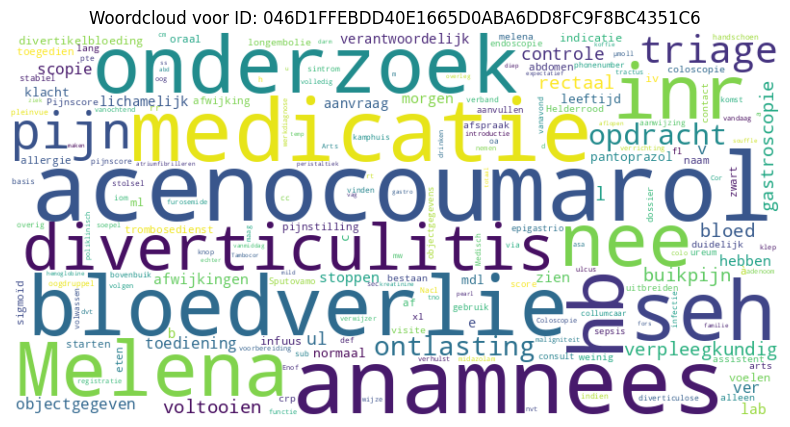

In [39]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def plot_wordcloud(word_freq_dict, id_):
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq_dict)
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Woordcloud voor ID: {id_}")
    plt.show()

# Visualiseer voor een specifieke ID (bijvoorbeeld de eerste in de lijst)
plot_wordcloud(df_grouped['word_counts'][0], df_grouped['pseudo_id'][0])



In [40]:
from collections import Counter

# Combine words per ID
# df_grouped = df_verslagen_clean.groupby('pseudo_id')['content_words_lemmatized'].apply(lambda x: " ".join(x)).reset_index()

# Compute word frequencies
df_grouped['word_counts'] = df_grouped['content_words_lemmatized'].apply(lambda text: Counter(text.split()))

# Get top 10 words per ID
df_grouped['top_10_words'] = df_grouped['word_counts'].apply(lambda counter: counter.most_common(10))

df_grouped[['pseudo_id', 'top_10_words']].head()


,pseudo_id,top_10_words
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"[(acenocoumarol, 41), (anamnees, 37), (medicat..."
1,088C9FD98B8B2CBCB597C17C07AC1845B21F0849,"[(anemie, 255), (oraal, 205), (iv, 203), (os, ..."
2,0A5645E02FA818D1629926B6BEFA81CF91C25A46,"[(oraal, 110), (tablet, 87), (af, 79), (onderz..."
3,0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,"[(opdracht, 72), (itp, 52), (onderzoek, 50), (..."
4,0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,"[(poli, 644), (iliaca, 622), (anemie, 542), (c..."


In [41]:
df_grouped

df_grouped['top_10_normalized_words'] = df_grouped['normalized_word_counts'].apply(lambda x: dict(Counter(x).most_common(10)))
df_grouped['top_10_normalized_words_only'] = df_grouped['top_10_normalized_words'].apply(lambda x: list(x.keys()))
df_grouped[['pseudo_id', 'top_10_normalized_words', 'top_10_normalized_words_only']].head()

,pseudo_id,top_10_normalized_words,top_10_normalized_words_only
0,046D1FFEBDD40E1665D0ABA6DD8FC9F8BC4351C6,"{'acenocoumarol': 0.01000243961941937, 'anamne...","[acenocoumarol, anamnees, medicatie, bloedverl..."
1,088C9FD98B8B2CBCB597C17C07AC1845B21F0849,"{'anemie': 0.0083986562150056, 'oraal': 0.0067...","[anemie, oraal, iv, os, psoriasis, poli, onder..."
2,0A5645E02FA818D1629926B6BEFA81CF91C25A46,"{'oraal': 0.009048284938718433, 'tablet': 0.00...","[oraal, tablet, af, onderzoek, behandeling, no..."
3,0BC512A65442D0BB4B00FBE05E7EA6283E5C11FD,"{'opdracht': 0.009134737376300432, 'itp': 0.00...","[opdracht, itp, onderzoek, anamnees, hypertens..."
4,0DD73490997F61870C32B3BB7C9CDE4E801FFF7D,"{'poli': 0.010855091273787651, 'iliaca': 0.010...","[poli, iliaca, anemie, chronisch, nierinsuffic..."


In [42]:
from collections import Counter

all_top_10_words = [word for sublist in df_grouped['top_10_normalized_words_only'] for word in sublist]
print(all_top_10_words)
# Count the frequency of each word in all_top_10_words
word_counts = Counter(all_top_10_words)
print(word_counts)

['acenocoumarol', 'anamnees', 'medicatie', 'bloedverlie', 'seh', 'onderzoek', 'inr', 'Melena', 'hb', 'nee', 'anemie', 'oraal', 'iv', 'os', 'psoriasis', 'poli', 'onderzoek', 'status', 'okt', 'osteomyelitis', 'oraal', 'tablet', 'af', 'onderzoek', 'behandeling', 'normaal', 'starten', 'wd', 'rivaroxaban', 'pt', 'opdracht', 'itp', 'onderzoek', 'anamnees', 'hypertensie', 'iii', 'af', 'afspraak', 'anemie', 'laat', 'poli', 'iliaca', 'anemie', 'chronisch', 'nierinsufficiëntie', 'stenose', 'hypertensie', 'Ckd', 'onderzoek', 'cva', 'opdracht', 'pouch', 'afspraak', 'poli', 'controle', 'anamnees', 'laboratorium', 'e', 'ileoanaal', 'uitbreiden', 'bloedverlie', 'rbl', 'bloed', 'hb', 'normaal', 'diverticulitis', 'onderzoek', 'rectaal', 'coloscopie', 'bloeding', 'obinutuzumab', 'cll', 'copd', 'opname', 'volgen', 'starten', 'beiderzijds', 'progressie', 'venetoclax', 'I', 'anemie', 'normaal', 'hb', 'onderzoek', 'tablet', 'klinisch', 'struma', 'Clopidogrel', 'oraal', 'bekend', 'anamnees', 'epilepsie', 'ne